**Trabajo de Fin de Grado**
- Autor: Pablo González Martín  
- Director: Carlos Javier Pérez González 

Grado en Matemáticas  
Universidad de La Laguna  
2024/25

Este notebook forma parte del Trabajo de Fin de Grado titulado *“Fundamentos de las redes neuronales
convolucionales y su aplicación en la
detección de enfermedades oculares”*, cuyo objetivo es desarrollar un modelo de clasificación de enfermedades oculares a partir de imágenes médicas.

En este notebook se recorren los siguientes ámbitos:

- Red neuronal sin librerías especializadas, solo operaciones algebraicas.
- Descenso por gradiente de forma visual
- Diferentes funciones de activación
- Ejemplos de redes con Tensorflow y sus aplicaciones de forma visual 
- Efecto de los optimizadores
- Efecto de diferentes tipos de regularización sobre los pesos

El objetivo de este notebook es ilustrar el transfondo matemático de las redes neuronales. Aplicaremos un ejemplo con el dataset del MNIST de números de 0 al 9 escritos a mano. Se emplearán librerías no especializadas en redes neuronales para construir, desde 0, una red neuronal. El objetivo es evitar el uso de sklearn o tensorflow/keras que pueden actuar como 'black boxes' de los algoritmos.

*Imports*

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
import seaborn as sns
from sklearn.metrics import confusion_matrix
from tqdm import tqdm
from colorama import Fore, Style

from rich.table import Table
from rich.console import Console
import rich.box
import random

## Datos

**Link de descarga:** alamacenar en el mismo directorio que este notebook

https://storage.googleapis.com/tensorflow/tf-keras-datasets/mnist.npz

In [2]:
import urllib.request

url = "https://storage.googleapis.com/tensorflow/tf-keras-datasets/mnist.npz"
filename = "mnist.npz"

urllib.request.urlretrieve(url, filename)
print("Descarga completada.")

Descarga completada.


In [5]:
mnist_data = np.load('mnist.npz')

In [3]:
mnist_data.keys()   #observamos que el dataset ya se encuentra dividido en conjuntos de entrenamiento y testeo.

KeysView(NpzFile 'mnist.npz' with keys: x_test, x_train, y_train, y_test)

In [4]:
x_train = mnist_data['x_train']  # Imágenes de entrenamiento
y_train = mnist_data['y_train']  # Etiquetas correspondientes
print(f"x_train shape: {x_train.shape}")
print(f"y_train shape: {y_train.shape}")
# Aplanar las imágenes de 28x28 a vectores de 784 (28*28)
x_train_flat = x_train.reshape(x_train.shape[0], -1)  # Cada fila es una imagen aplanada
df_train = pd.DataFrame(x_train_flat)
df_train['label'] = y_train

x_train shape: (60000, 28, 28)
y_train shape: (60000,)


In [5]:
x_test = mnist_data['x_test']  # Imágenes de entrenamiento
y_test = mnist_data['y_test']  # Etiquetas correspondientes
print(f"x_test shape: {x_test.shape}")
print(f"y_test shape: {y_test.shape}")
# Aplanar las imágenes de 28x28 a vectores de 784 (28*28)
x_test_flat = x_test.reshape(x_test.shape[0], -1)  # Cada fila es una imagen aplanada
df_test = pd.DataFrame(x_test_flat)
df_test['label'] = y_test

x_test shape: (10000, 28, 28)
y_test shape: (10000,)


In [6]:
# Cambiar el número máximo de columnas a mostrar
pd.set_option('display.max_columns', 1000)

# Cambiar el número máximo de filas a mostrar
pd.set_option('display.max_rows', 100)

# Cambiar el ancho máximo del contenido de las columnas
pd.set_option('display.max_colwidth', 10)

# Cambiar el ancho máximo total de la pantalla
pd.set_option('display.width', 10000)

Cada imagen es una fila (28x28=784 píxeles) y la última columna representa la etiqueta o 'label' asociado a cada imagen

In [7]:
df_train.head(100)
df_test.head(100)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,label
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,84,185,159,151,60,36,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,222,254,254,254,254,241,198,198,198,198,198,198,198,198,170,52,0,0,0,0,0,0,0,0,0,0,0,0,67,114,72,114,163,227,254,225,254,254,254,250,229,254,254,140,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,17,66,14,67,67,67,59,21,236,254,106,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,83,253,209,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,22,233,255,83,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,129,254,238,44,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,59,249,254,62,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [8]:
n0=784
data_train = np.array(df_train).T     #en una red los datos de entrada deben ser datos columna po eso hacemos la transpuesta 
Y_train = data_train[-1]  #Última fila de labels
X_train = data_train[0:n0,:]  
_,m = X_train.shape

In [9]:
def mostrar_img(df,index):
    n0=784
    current_image = df[:n0, index]
    current_image = current_image.reshape((28, 28))
    # Escalar los valores al rango 0-1 si no están ya en ese rango
    current_image = (current_image - np.min(current_image)) / (np.max(current_image) - np.min(current_image))
    plt.figure(figsize=(5, 5))  # Ajustar tamaño de la figura
    plt.imshow(current_image, cmap='gray', interpolation='nearest')  # Agregar barra de color para contexto
    plt.axis('off')  # Quitar ejes para una visualización más limpia
    plt.show()

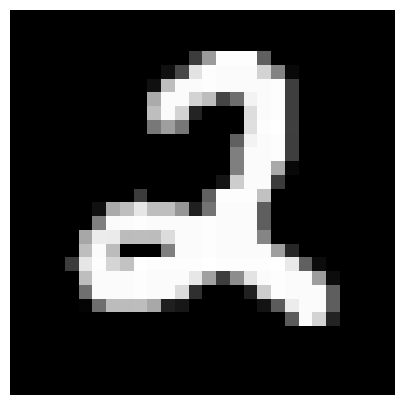

In [10]:
mostrar_img(X_train,213)

In [11]:
data_test =np.array(df_test).T  
Y_test = data_test[-1]
X_test = data_test[0:n0,:]
_,m_test = X_test.shape

## Estructura de la red

Inicialización

In [12]:
n1=15   #nº neuronas de la primera capa (modificable)
n2=10    #nº neuronas de la segunda capa (no modificable ya que tiene que ser igual al número de clases que son 10)
def init_paramns():
    W1 = np.random.randn(n1, n0)*0.01   #matriz inicial 10x784  (con pesos con poca escala)  #(-1,1)
    b1 = np.zeros((n1, 1)) # Inicial a cero
    W2 = np.random.randn(n2, n1)*0.01
    b2 = np.zeros((n2, 1)) 
    return [W1,b1,W2,b2]

Funciones de activación

In [13]:
def ReLU(Z):
    return np.maximum(0,Z)   #coge valores positivos

def softmax(Z):
    exp = np.exp(Z - np.max(Z))   
#Se resta el valor máximo de Z (con np.max(Z)) de cada elemento de Z para evitar problemas 
# de desbordamiento numérico. Esto asegura que los valores de exp(Z - np.max(Z)) 
# no crezcan demasiado grandes y evita que el cómputo de la exponencial cause errores de precisión.
    return exp / exp.sum(axis=0)

def deriv_RelU(Z):    
    return Z>0   #derivada de ReLU

Forward propagation

In [14]:
def forward_prop(W1,b1,W2,b2,X):
    Z1 = W1.dot(X) + b1
    A1 = ReLU(Z1)
    Z2 = W2.dot(A1) + b2
    A2 = softmax(Z2)
    return Z1, A1, Z2, A2

Backpropagation

In [15]:
def one_hot(Y):
    '''Transforma el vector de labels en una matriz donde cada columna es una imagen con un 1 en la posición del valor del label'''
    one_hot_Y = np.zeros((Y.size, Y.max() + 1)) # Matriz de ceros. Al usar Y.max() evitamos crear una matriz más grande de lo necesario
    one_hot_Y[np.arange(Y.size), Y] = 1  #cambiamos los valores en la posición Y por un 1
    one_hot_Y= one_hot_Y.T
    return one_hot_Y


def back_prop (Z1, A1, A2, W2, X, Y):   #backpropagation algoritmo
    one_hot_Y= one_hot(Y)
    dZ2= A2 - one_hot_Y
    dW2=(1/m)*dZ2.dot(A1.T)
    db2=(1/m)*np.sum(dZ2, axis=1, keepdims=True)  #sum of the columns
    dZ1 = W2.T.dot(dZ2)*deriv_RelU(Z1)  # * represesnta la multiplicación elemento a elemento
    dW1=(1/m)*dZ1.dot(X.T)
    db1=(1/m)*np.sum(dZ1, axis=1, keepdims=True)
    return dW1, db1, dW2, db2    

Gradient descent

In [16]:
def update_paramns(W1, b1, W2, b2, dW1, db1, dW2, db2, alpha):    #gradient descent
    W1 = W1 - alpha * dW1
    b1 = b1 - alpha * db1    
    W2 = W2 - alpha * dW2  
    b2 = b2 - alpha * db2    
    return W1, b1, W2, b2

def get_predictions(A2):
    return np.argmax(A2, axis=0)   #el que más probabilidad tenga

def get_accuracy(predictions, Y):
    return np.sum(predictions == Y) / Y.size

Entrenamiento

In [17]:
iterations=200    #establecer
alpha=0.002    #learning rate

In [18]:
def gradient_descent(X, Y, alpha, iterations):
    W1, b1, W2, b2 = init_paramns()
    accuracies_10it = []
    start_time = time.time()
    
    print(Fore.CYAN + "Entrenando la red neuronal..." + Style.RESET_ALL)
    for i in tqdm(range(iterations), desc="Progreso"):
        Z1, A1, Z2, A2 = forward_prop(W1, b1, W2, b2, X)
        dW1, db1, dW2, db2 = back_prop(Z1, A1, A2, W2, X, Y)
        W1, b1, W2, b2 = update_paramns(W1, b1, W2, b2, dW1, db1, dW2, db2, alpha)
        
        if i % 10 == 0:
            predictions = get_predictions(A2)
            accuracy = get_accuracy(predictions, Y)
            accuracies_10it.append(accuracy)
            print(Fore.YELLOW + f"Iteración {i}: Precisión = {accuracy:.2%}" + Style.RESET_ALL)
            if accuracy > 0.9:
                print(Fore.GREEN + f"¡Precisión mayor al 90%! Deteniendo entrenamiento en la iteración {i}." + Style.RESET_ALL)
                break
    
    total_time = time.time() - start_time
    print(Fore.MAGENTA + f"Tiempo total de entrenamiento: {total_time:.2f} segundos" + Style.RESET_ALL)
    return W1, b1, W2, b2, accuracies_10it

W1, b1, W2, b2, accuracies_10it = gradient_descent(X_train, Y_train, alpha, iterations)

Entrenando la red neuronal...


Progreso:   0%|          | 1/200 [00:00<01:48,  1.83it/s]

Iteración 0: Precisión = 13.79%


Progreso:   6%|▌         | 11/200 [00:05<01:37,  1.95it/s]

Iteración 10: Precisión = 65.34%


Progreso:  10%|█         | 21/200 [00:10<01:30,  1.97it/s]

Iteración 20: Precisión = 53.59%


Progreso:  16%|█▌        | 31/200 [00:15<01:21,  2.08it/s]

Iteración 30: Precisión = 80.20%


Progreso:  20%|██        | 41/200 [00:20<01:21,  1.94it/s]

Iteración 40: Precisión = 80.16%


Progreso:  26%|██▌       | 51/200 [00:26<01:22,  1.80it/s]

Iteración 50: Precisión = 80.90%


Progreso:  30%|███       | 61/200 [00:31<01:13,  1.88it/s]

Iteración 60: Precisión = 86.27%


Progreso:  36%|███▌      | 71/200 [00:36<01:08,  1.88it/s]

Iteración 70: Precisión = 83.12%


Progreso:  40%|████      | 81/200 [00:41<01:01,  1.95it/s]

Iteración 80: Precisión = 87.83%


Progreso:  46%|████▌     | 91/200 [00:46<00:55,  1.96it/s]

Iteración 90: Precisión = 88.48%


Progreso:  50%|█████     | 101/200 [00:51<00:51,  1.94it/s]

Iteración 100: Precisión = 88.42%


Progreso:  56%|█████▌    | 111/200 [00:56<00:41,  2.17it/s]

Iteración 110: Precisión = 87.09%


Progreso:  60%|██████    | 121/200 [01:01<00:36,  2.18it/s]

Iteración 120: Precisión = 89.47%


Progreso:  66%|██████▌   | 131/200 [01:05<00:30,  2.24it/s]

Iteración 130: Precisión = 89.77%


Progreso:  70%|███████   | 141/200 [01:10<00:26,  2.20it/s]

Iteración 140: Precisión = 89.94%


Progreso:  76%|███████▌  | 151/200 [01:14<00:21,  2.25it/s]

Iteración 150: Precisión = 89.95%


Progreso:  80%|████████  | 161/200 [01:19<00:17,  2.20it/s]

Iteración 160: Precisión = 88.96%


Progreso:  86%|████████▌ | 171/200 [01:23<00:13,  2.20it/s]

Iteración 170: Precisión = 90.00%


Progreso:  90%|█████████ | 180/200 [01:28<00:09,  2.04it/s]

Iteración 180: Precisión = 90.62%
¡Precisión mayor al 90%! Deteniendo entrenamiento en la iteración 180.
Tiempo total de entrenamiento: 88.31 segundos


Hacer predicciones (una vez calculadas W1, b1, W2, b2)

In [19]:
def make_predictions(X, W1, b1, W2, b2):
    _, _, _, A2 = forward_prop(W1, b1, W2, b2, X)
    predictions = get_predictions(A2)
    return predictions

def test_prediction(index, W1, b1, W2, b2):
    current_image = X_test[:, index,None]
    prediction = make_predictions(X_test[:, index,None], W1, b1, W2, b2)
    label = Y_test[index]
    print("Prediction: ", prediction)
    print("Label: ", label)
    current_image = current_image.reshape((28, 28))
    plt.gray()
    plt.imshow(current_image, interpolation='nearest')
    plt.show()

**Visualizando la foward propagation**

Visualizamos la forward propagation de datos individuales

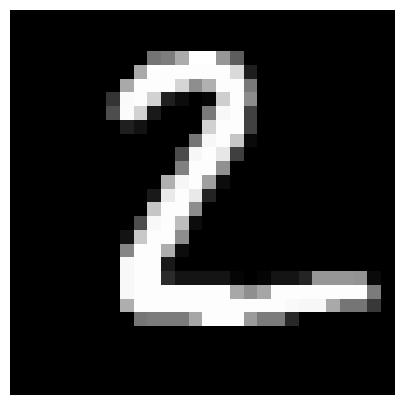

In [20]:
mostrar_img(data_test,1)

In [21]:
def imprimir_matriz_columna(matriz):
    matriz = matriz.reshape(-1, 1)

    # Crear consola
    console = Console()

    # Crear tabla con bordes completos
    tabla = Table(show_header=False, header_style="bold magenta", show_lines=True, box=rich.box.SQUARE)

    # Agregar solo UNA columna
    tabla.add_column(justify="center")

    # Agregar filas a la tabla con dos decimales
    for fila in matriz:
        tabla.add_row(f"{fila[0]:.4f}")  # Formateamos a dos decimales

    # Mostrar la tabla en consola
    console.print(tabla)

def visualizar_forwardprop(df,index,W1,b1,W2,b2):
    print(f'La imagen es un {df[-1, index]}')
    mostrar_img(df,index)
    x=df[:n0, index].reshape(-1, 1)
    b1=b1.reshape(-1, 1)
    A1=ReLU(W1.dot(x)+b1)
    print('Primera capa tras activación ReLU')
    imprimir_matriz_columna(A1)
    A2=softmax(W2.dot(A1)+b2)
    print('Segunda capa tras activación Softmax')
    imprimir_matriz_columna(A2)
    Y=np.argmax(A2, axis=0)
    print('Salida de la red neuronal, tras aplicar argmax()')
    imprimir_matriz_columna(Y)
    print(f'Observamos que en la segunda capa la clase {df[-1, index]} tiene una probabilidad de {np.max(A2):.2f} ({np.max(A2)*100:.2f} %)')  

La imagen es un 4


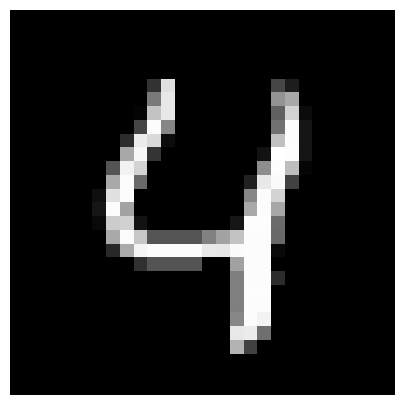

Primera capa tras activación ReLU


┌─────────┐
│ 61.9377 │
├─────────┤
│ 0.0000  │
├─────────┤
│ 48.7490 │
├─────────┤
│ 0.0000  │
├─────────┤
│ 52.0150 │
├─────────┤
│ 35.8050 │
├─────────┤
│ 40.7539 │
├─────────┤
│ 7.5466  │
├─────────┤
│ 0.0000  │
├─────────┤
│ 0.0000  │
├─────────┤
│ 74.1345 │
├─────────┤
│ 0.0000  │
├─────────┤
│ 32.1839 │
├─────────┤
│ 0.0000  │
├─────────┤
│ 0.0000  │
└─────────┘

Segunda capa tras activación Softmax


┌────────┐
│ 0.0009 │
├────────┤
│ 0.0000 │
├────────┤
│ 0.0226 │
├────────┤
│ 0.0009 │
├────────┤
│ 0.7988 │
├────────┤
│ 0.0008 │
├────────┤
│ 0.0020 │
├────────┤
│ 0.0203 │
├────────┤
│ 0.0318 │
├────────┤
│ 0.1218 │
└────────┘

Salida de la red neuronal, tras aplicar argmax()


┌────────┐
│ 4.0000 │
└────────┘

Observamos que en la segunda capa la clase 4 tiene una probabilidad de 0.80 (79.88 %)


In [22]:
index=4
visualizar_forwardprop(data_test,index,W1,b1,W2,b2)

## Conclusiones del modelo

Visualizando evolución de la precisión

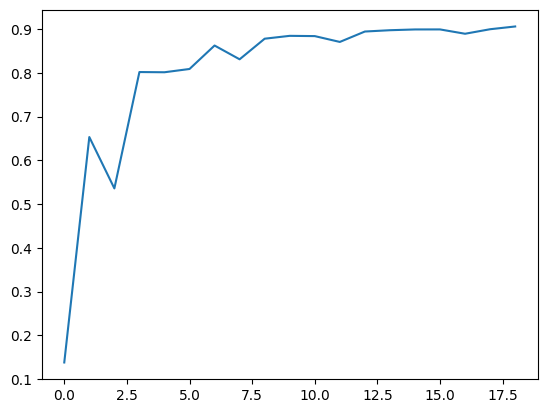

In [23]:
plt.plot(range(len(accuracies_10it)), accuracies_10it)   # se oberva como se acerca al 90% (importante: esta es la precisión sobre el conjunto de entrenamiento)

Precisión Generalizada tras entrenamiento (es decir, la precisión sobre el conjunto de testeo)

In [24]:
predictions=make_predictions(X_test, W1, b1, W2, b2)
accuracy=get_accuracy(predictions, Y_test)
print(f'{accuracy*100:.2f} %')

91.34 %


Ejemplos de predicciones

Prediction:  [4]
Label:  4


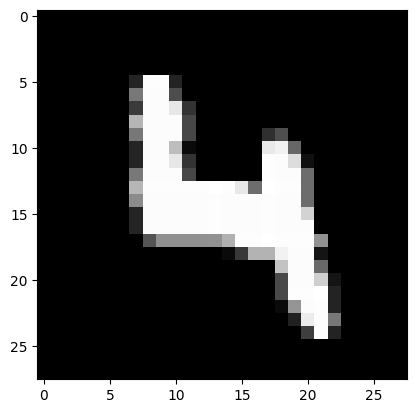

Prediction:  [8]
Label:  8


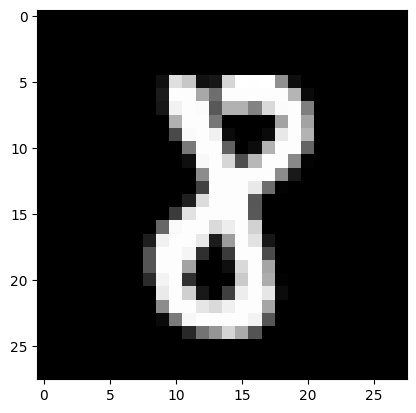

Prediction:  [0]
Label:  0


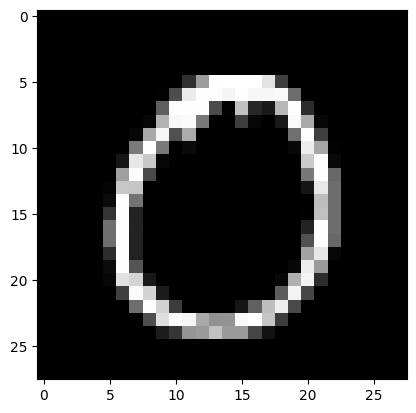

Prediction:  [3]
Label:  3


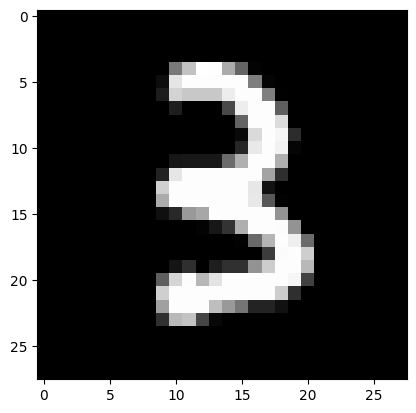

Prediction:  [1]
Label:  1


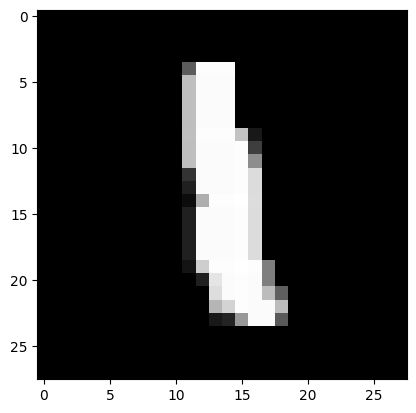

Prediction:  [8]
Label:  8


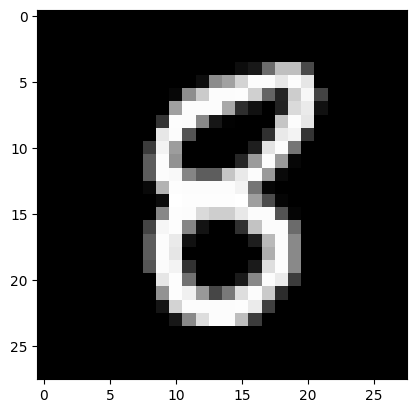

Prediction:  [1]
Label:  1


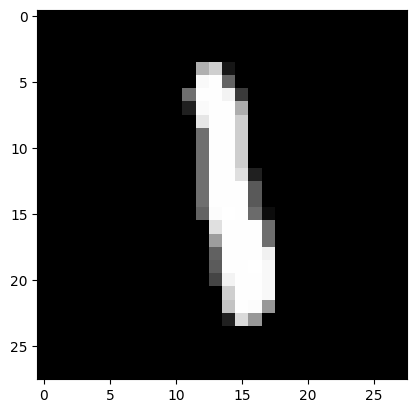

Prediction:  [0]
Label:  0


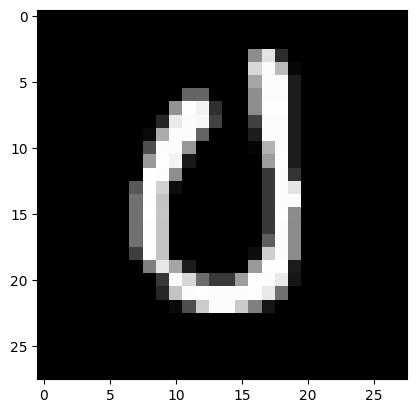

Prediction:  [7]
Label:  7


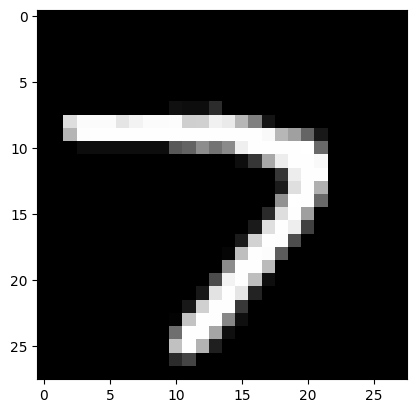

Prediction:  [8]
Label:  8


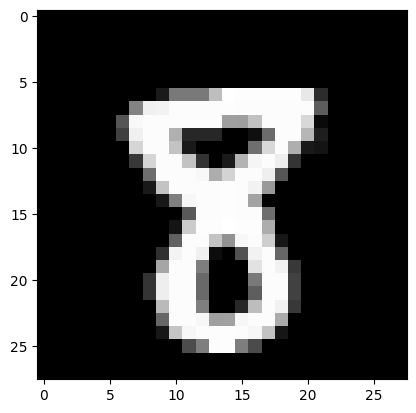

Prediction:  [7]
Label:  7


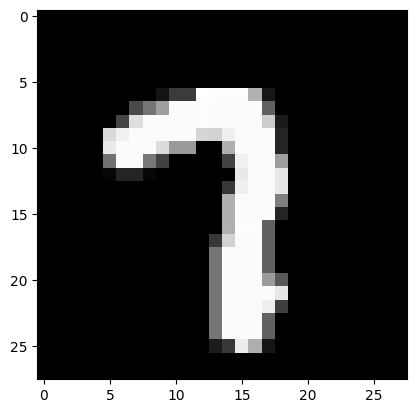

Prediction:  [3]
Label:  3


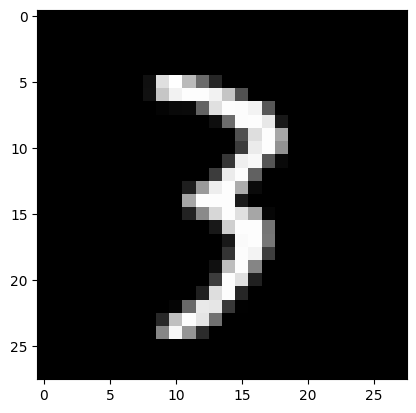

Prediction:  [6]
Label:  6


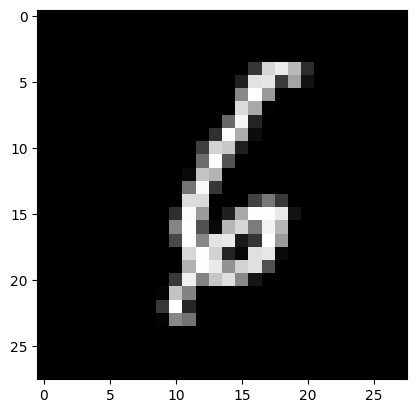

Prediction:  [9]
Label:  9


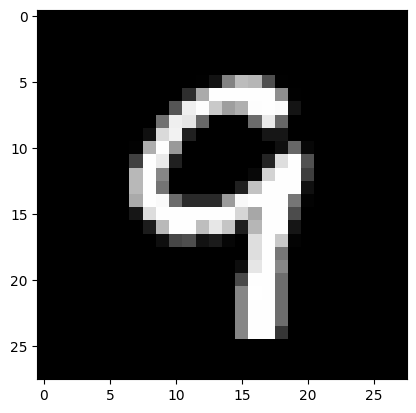

Prediction:  [3]
Label:  3


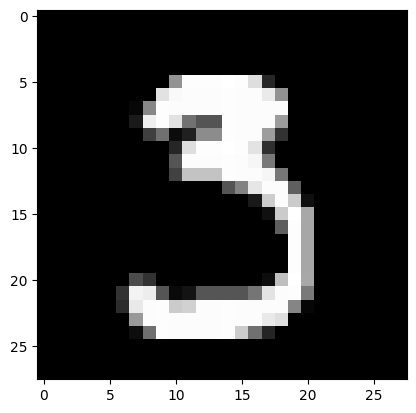

In [25]:
num_samples = 15 
random_indices = random.sample(range(len(X_test)), num_samples)  

for i in random_indices:
    test_prediction(i, W1, b1, W2, b2)

Estudio de números o parejas de números que más fallan

In [26]:
predictions = make_predictions(X_test, W1, b1, W2, b2) # Vector de predicciones del modelo
labels = Y_test

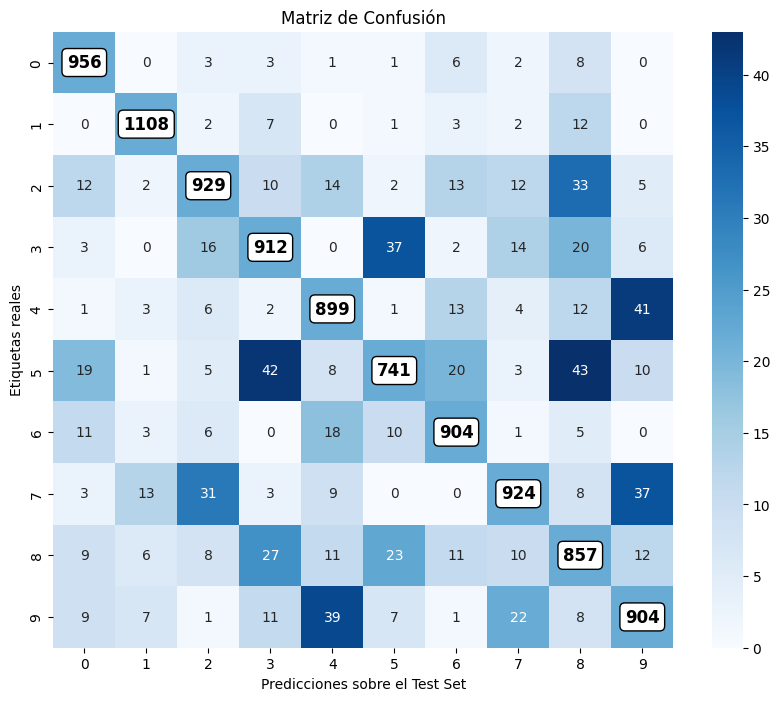

In [27]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Crear la matriz de confusión
conf_matrix = confusion_matrix(labels, predictions)

# Crear una copia para modificar la diagonal sin cambiar la original
masked_conf_matrix = conf_matrix.copy()

# Definir un valor constante para la diagonal (por ejemplo, el promedio de la matriz)
diagonal_value = masked_conf_matrix.max() /50
np.fill_diagonal(masked_conf_matrix, diagonal_value)  

# Crear la figura
plt.figure(figsize=(10, 8))

# Dibujar el heatmap de toda la matriz
sns.heatmap(masked_conf_matrix, annot=True, cmap="Blues", xticklabels=range(10), yticklabels=range(10))

# Dibujar la diagonal con un color uniforme
for i in range(len(conf_matrix)):
    plt.text(i + 0.5, i + 0.5, conf_matrix[i, i], ha="center", va="center", color="black", fontsize=12, fontweight="bold", bbox=dict(facecolor="white", edgecolor="black", boxstyle="round,pad=0.3"))

# Etiquetas
plt.xlabel("Predicciones sobre el Test Set")
plt.ylabel("Etiquetas reales")
plt.title("Matriz de Confusión")

plt.show()

In [28]:
conf_matrix_no_diag = conf_matrix.copy()
np.fill_diagonal(conf_matrix_no_diag, 0)
# Identificar los pares con más errores
max_error_pairs = np.unravel_index(np.argsort(-conf_matrix_no_diag, axis=None), conf_matrix_no_diag.shape)
top_pairs = [(i, j, conf_matrix_no_diag[i, j]) for i, j in zip(*max_error_pairs) if conf_matrix_no_diag[i, j] > 0]

# Mostrar los 5 pares con más errores
print("Los 5 pares de dígitos con más errores:")
for i, (real, pred, count) in enumerate(top_pairs[:5]):
    print(f"{i + 1}. Real: {real}, Predicho: {pred}, Errores: {count}")



Los 5 pares de dígitos con más errores:
1. Real: 5, Predicho: 8, Errores: 43
2. Real: 5, Predicho: 3, Errores: 42
3. Real: 4, Predicho: 9, Errores: 41
4. Real: 9, Predicho: 4, Errores: 39
5. Real: 7, Predicho: 9, Errores: 37


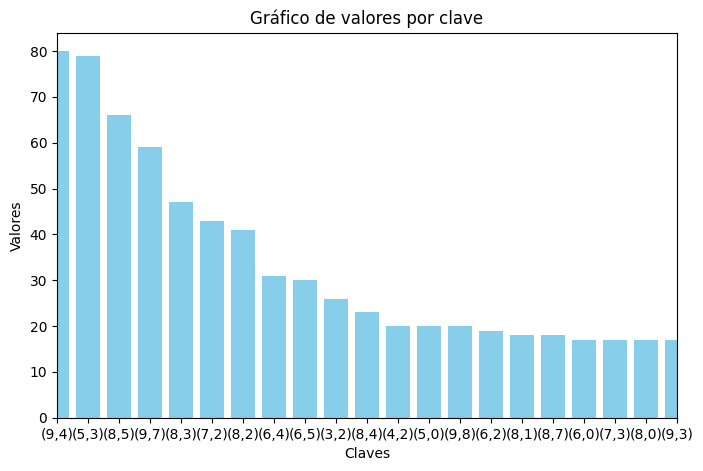

In [29]:
np.fill_diagonal(conf_matrix, 0)
conf_matrix
conf_matrix.T
M=conf_matrix.T+conf_matrix
M
dic={}
for i in range(0,10):
    for j in range(0,10):
        if j<i and j!=i:
            dic[f'({i},{j})']=M[i,j]

datos_ordenados = dict(sorted(dic.items(), key=lambda item: item[1], reverse=True))
claves = list(datos_ordenados.keys())    # Eje X
valores = list(datos_ordenados.values()) # Eje Y
# Crear el gráfico de barras
plt.figure(figsize=(8, 5))     # Ajustar tamaño del gráfico
plt.bar(claves, valores, color='skyblue')  # Crear barras

# Etiquetas de los ejes
plt.xlabel('Claves')
plt.ylabel('Valores')
plt.title('Gráfico de valores por clave')



plt.xlim(0, 20)
# Mostrar el gráfico
plt.show()

[[ 0.     0.    12.5   12.5    4.167  4.167 25.     8.333 33.333  0.   ]
 [ 0.     0.     7.407 25.926  0.     3.704 11.111  7.407 44.444  0.   ]
 [11.65   1.942  0.     9.709 13.592  1.942 12.621 11.65  32.039  4.854]
 [ 3.061  0.    16.327  0.     0.    37.755  2.041 14.286 20.408  6.122]
 [ 1.205  3.614  7.229  2.41   0.     1.205 15.663  4.819 14.458 49.398]
 [12.583  0.662  3.311 27.815  5.298  0.    13.245  1.987 28.477  6.623]
 [20.37   5.556 11.111  0.    33.333 18.519  0.     1.852  9.259  0.   ]
 [ 2.885 12.5   29.808  2.885  8.654  0.     0.     0.     7.692 35.577]
 [ 7.692  5.128  6.838 23.077  9.402 19.658  9.402  8.547  0.    10.256]
 [ 8.571  6.667  0.952 10.476 37.143  6.667  0.952 20.952  7.619  0.   ]]


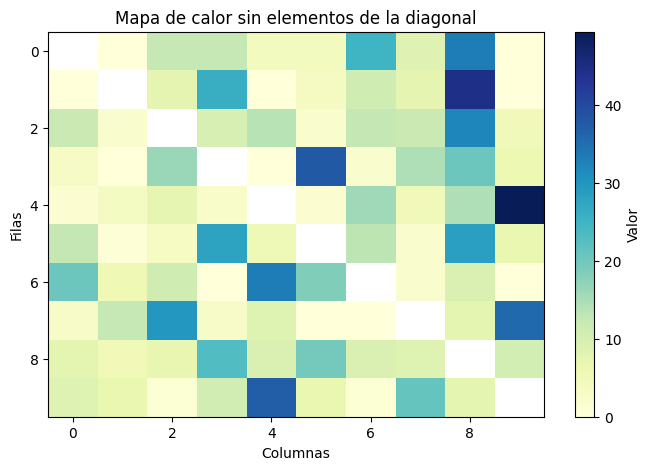

In [30]:
suma_filas = conf_matrix.sum(axis=1, keepdims=True)
matriz_normalizada = (conf_matrix / suma_filas)*100

np.set_printoptions(precision=3, suppress=True)
print(matriz_normalizada)
# Crear una copia de la matriz y reemplazar la diagonal por NaN
matriz_sin_diagonal = matriz_normalizada.copy()
np.fill_diagonal(matriz_sin_diagonal, np.nan)

# Crear el mapa de calor
plt.figure(figsize=(8, 5))
plt.imshow(matriz_sin_diagonal, cmap='YlGnBu', aspect='auto', interpolation='nearest')

# Etiquetas y título
plt.colorbar(label='Valor')
plt.xlabel('Columnas')
plt.ylabel('Filas')
plt.title('Mapa de calor sin elementos de la diagonal')

# Mostrar el gráfico
plt.show()

# Gradient Descent

Ejemplo sobre una superficie 2D del gradient descent

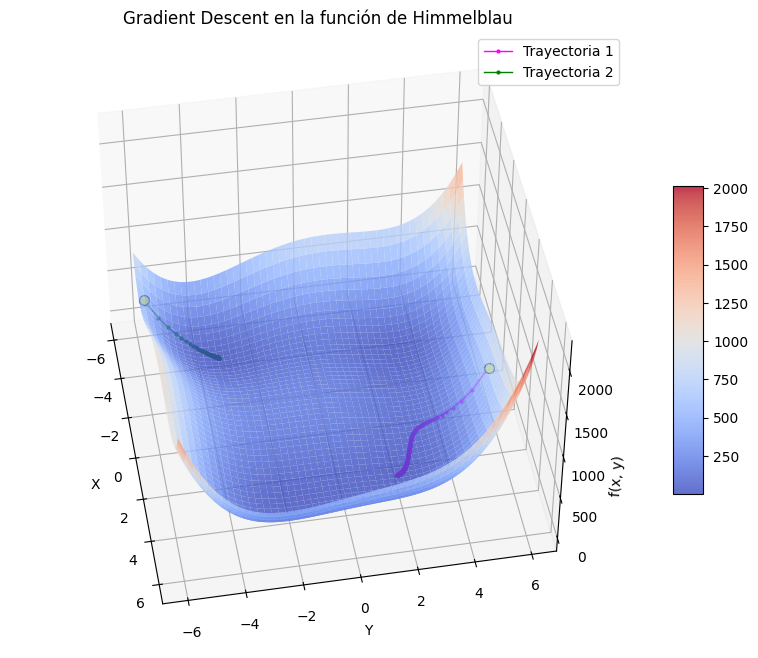

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Definimos la función de Himmelblau
def himmelblau(x, y):
    return (x**2 + y - 11)**2 + (x + y**2 - 7)**2

# Configuración del Gradient Descent
def grad_himmelblau(x, y):
    df_dx = 4*x*(x**2 + y - 11) + 2*(x + y**2 - 7)
    df_dy = 2*(x**2 + y - 11) + 4*y*(x + y**2 - 7)
    return np.array([df_dx, df_dy])

learning_rate = 0.001
iterations = 1000
starting_points = [np.array([1, 5.6]), np.array([-5, -5.8])]  # Dos puntos iniciales

histories = []
for start_point in starting_points:
    point = start_point.copy()
    history = [point.copy()]
    for _ in range(iterations):
        grad = grad_himmelblau(point[0], point[1])
        point = point - learning_rate * grad
        history.append(point.copy())
    histories.append(np.array(history))

# Crear la malla para la superficie
x = np.linspace(-6, 6, 400)
y = np.linspace(-6, 6, 400)
X, Y = np.meshgrid(x, y)
Z = himmelblau(X, Y)

# Crear la figura
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Agregar la superficie
surf = ax.plot_surface(X, Y, Z, cmap='coolwarm', edgecolor='none', alpha=0.8)

# Agregar las trayectorias del Gradient Descent
colors = ['magenta', 'green']
for i, history in enumerate(histories):
    ax.plot(history[:, 0], history[:, 1], himmelblau(history[:, 0], history[:, 1]),
            marker='o', markersize=2, color=colors[i], linestyle='-', linewidth=1,
            label=f'Trayectoria {i+1}')
    
    # Agregar puntos de inicio en amarillo y más grandes
    ax.scatter(starting_points[i][0], starting_points[i][1], 
               himmelblau(starting_points[i][0], starting_points[i][1]),
               color='yellow', s=50, edgecolors='black')

# Configuración de la gráfica
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('f(x, y)')
ax.set_title('Gradient Descent en la función de Himmelblau')
ax.legend()

# Ajuste del ángulo de vista 3D y barra de color
ax.view_init(elev=45, azim=-10)
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10)

plt.show()


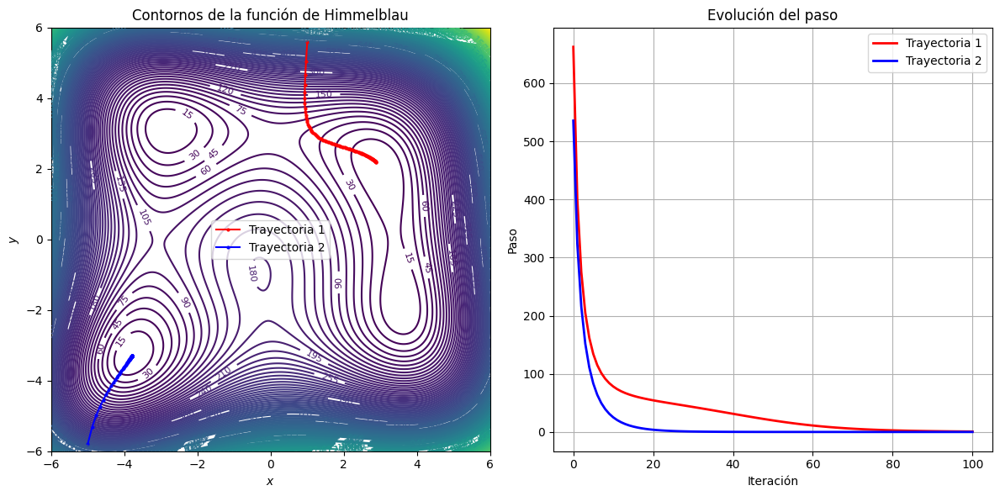

In [33]:
import numpy as np
import matplotlib.pyplot as plt

# Definimos la función de Himmelblau
def himmelblau(x, y):
    return (x**2 + y - 11)**2 + (x + y**2 - 7)**2

# Gradiente de la función de Himmelblau
def grad_himmelblau(x, y):
    df_dx = 4*x*(x**2 + y - 11) + 2*(x + y**2 - 7)
    df_dy = 2*(x**2 + y - 11) + 4*y*(x + y**2 - 7)
    return np.array([df_dx, df_dy])

# Creamos una malla para la visualización de contornos
x_vals = np.linspace(-6, 6, 400)
y_vals = np.linspace(-6, 6, 400)
X, Y = np.meshgrid(x_vals, y_vals)
Z = himmelblau(X, Y)

# Configuración de la figura con dos subgráficos
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# --- Subgráfico izquierdo: Contornos de la función y trayectoria del Gradient Descent ---
contours = ax[0].contour(X, Y, Z, levels=170, cmap='viridis')
ax[0].clabel(contours, inline=True, fontsize=8)
ax[0].set_title("Contornos de la función de Himmelblau")
ax[0].set_xlabel(r'$x$')
ax[0].set_ylabel(r'$y$')

# --- Gradient Descent sobre la función de Himmelblau ---
alpha = 0.001        # Tasa de aprendizaje (puede ajustarse)
N = 100            # Número de iteraciones
starting_points = [np.array([1, 5.6]), np.array([-5, -5.8])]   # Dos puntos iniciales

histories = []
for start_point in starting_points:
    trajectory = [start_point.copy()]
    current_point = start_point.copy()
    for i in range(N):
        grad = grad_himmelblau(current_point[0], current_point[1])
        current_point = current_point - alpha * grad
        trajectory.append(current_point.copy())
    histories.append(np.array(trajectory))

# Graficamos las trayectorias del Gradient Descent sobre los contornos
colors = ['r', 'b']
for i, trajectory in enumerate(histories):
    ax[0].plot(trajectory[:, 0], trajectory[:, 1], marker='o', markersize=2,
               color=colors[i], linestyle='-', linewidth=1.5, label=f"Trayectoria {i+1}")
ax[0].legend()

# Subgráfico derecho: Evolución del costo (valor de la función) ---
for i, trajectory in enumerate(histories):
    cost_history = [himmelblau(pt[0], pt[1]) for pt in trajectory]
    ax[1].plot(range(len(cost_history)), cost_history, color=colors[i], lw=2, label=f"Trayectoria {i+1}")

ax[1].set_xlabel("Iteración")
ax[1].set_ylabel("Paso")
ax[1].set_title("Evolución del paso")
ax[1].grid(True)
ax[1].legend()

plt.tight_layout()
plt.show()

# Funciones de activación

Funciones de activación

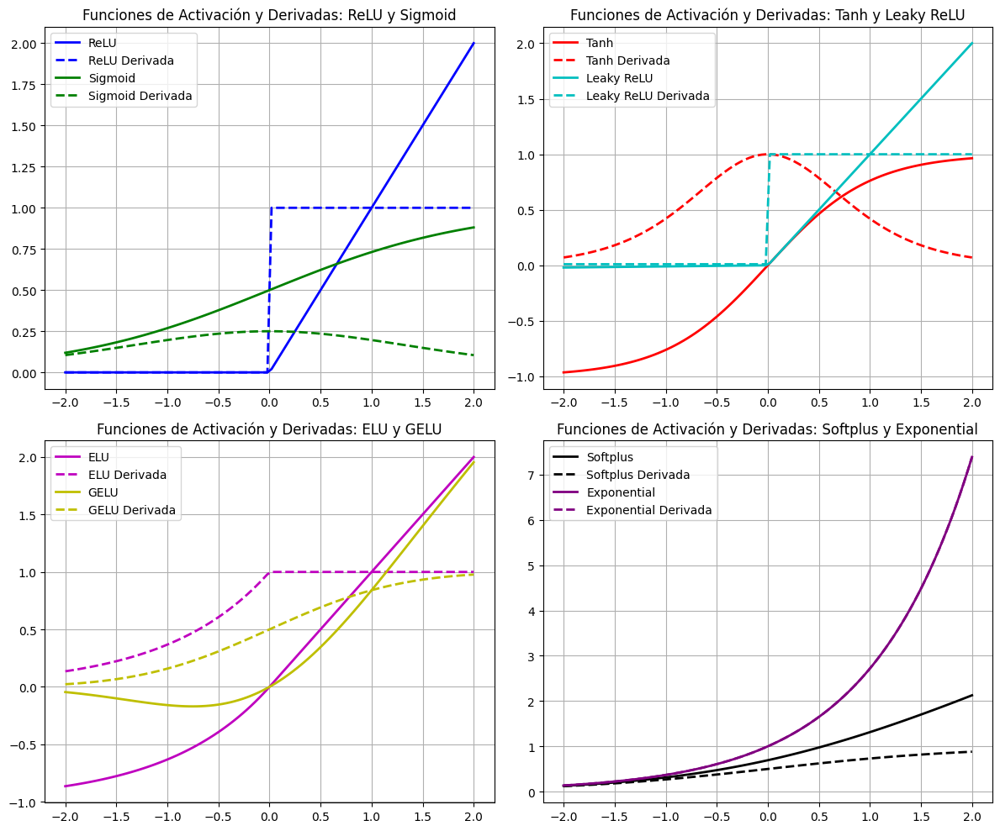

In [34]:
import numpy as np
import matplotlib.pyplot as plt

# Definir las funciones y sus derivadas
def relu(x):
    return np.maximum(0, x)

def relu_derivative(x):
    return np.where(x > 0, 1, 0)

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def sigmoid_derivative(x):
    sig = sigmoid(x)
    return sig * (1 - sig)

def tanh(x):
    return np.tanh(x)

def tanh_derivative(x):
    return 1 - np.tanh(x)**2

def leaky_relu(x, alpha=0.01):
    return np.where(x > 0, x, alpha * x)

def leaky_relu_derivative(x, alpha=0.01):
    return np.where(x > 0, 1, alpha)

def elu(x, alpha=1.0):
    return np.where(x >= 0, x, alpha * (np.exp(x) - 1))

def elu_derivative(x, alpha=1.0):
    return np.where(x >= 0, 1, alpha * np.exp(x))

def gelu(x):
    return 0.5 * x * (1 + np.tanh(np.sqrt(2 / np.pi) * (x + 0.044715 * x ** 3)))

def gelu_derivative(x):
    return 0.5 * (1 + np.tanh(np.sqrt(2 / np.pi) * (x + 0.044715 * x ** 3)))

def softplus(x):
    return np.log(1 + np.exp(x))

def softplus_derivative(x):
    return 1 / (1 + np.exp(-x))

# Añadir función exponencial y su derivada
def exponential(x):
    return np.exp(x)

def exponential_derivative(x):
    return np.exp(x)  # Derivada de exp(x) es exp(x)

# Rango de x
x = np.linspace(-2, 2, 100)

# Grosor de las líneas
line_thickness = 2

# Colores para cada función
colors = {
    'ReLU': 'b',
    'Sigmoid': 'g',
    'Tanh': 'r',
    'Leaky ReLU': 'c',
    'ELU': 'm',
    'GELU': 'y',
    'Softplus': 'k',
    'Exponential': 'purple'
}

# Graficar las funciones de activación y sus derivadas
fig, ax = plt.subplots(2, 2, figsize=(12, 10))

# Funciones de activación y derivadas en subgráficas
ax[0, 0].plot(x, relu(x), label="ReLU", color=colors['ReLU'], linewidth=line_thickness)
ax[0, 0].plot(x, relu_derivative(x), label="ReLU Derivada", color=colors['ReLU'], linestyle='--', linewidth=line_thickness)
ax[0, 0].plot(x, sigmoid(x), label="Sigmoid", color=colors['Sigmoid'], linewidth=line_thickness)
ax[0, 0].plot(x, sigmoid_derivative(x), label="Sigmoid Derivada", color=colors['Sigmoid'], linestyle='--', linewidth=line_thickness)
ax[0, 0].set_title('Funciones de Activación y Derivadas: ReLU y Sigmoid')
ax[0, 0].legend()
ax[0, 0].grid(True)

ax[0, 1].plot(x, tanh(x), label="Tanh", color=colors['Tanh'], linewidth=line_thickness)
ax[0, 1].plot(x, tanh_derivative(x), label="Tanh Derivada", color=colors['Tanh'], linestyle='--', linewidth=line_thickness)
ax[0, 1].plot(x, leaky_relu(x), label="Leaky ReLU", color=colors['Leaky ReLU'], linewidth=line_thickness)
ax[0, 1].plot(x, leaky_relu_derivative(x), label="Leaky ReLU Derivada", color=colors['Leaky ReLU'], linestyle='--', linewidth=line_thickness)
ax[0, 1].set_title('Funciones de Activación y Derivadas: Tanh y Leaky ReLU')
ax[0, 1].legend()
ax[0, 1].grid(True)

ax[1, 0].plot(x, elu(x), label="ELU", color=colors['ELU'], linewidth=line_thickness)
ax[1, 0].plot(x, elu_derivative(x), label="ELU Derivada", color=colors['ELU'], linestyle='--', linewidth=line_thickness)
ax[1, 0].plot(x, gelu(x), label="GELU", color=colors['GELU'], linewidth=line_thickness)
ax[1, 0].plot(x, gelu_derivative(x), label="GELU Derivada", color=colors['GELU'], linestyle='--', linewidth=line_thickness)
ax[1, 0].set_title('Funciones de Activación y Derivadas: ELU y GELU')
ax[1, 0].legend()
ax[1, 0].grid(True)

ax[1, 1].plot(x, softplus(x), label="Softplus", color=colors['Softplus'], linewidth=line_thickness)
ax[1, 1].plot(x, softplus_derivative(x), label="Softplus Derivada", color=colors['Softplus'], linestyle='--', linewidth=line_thickness)
ax[1, 1].plot(x, exponential(x), label="Exponential", color=colors['Exponential'], linewidth=line_thickness)
ax[1, 1].plot(x, exponential_derivative(x), label="Exponential Derivada", color=colors['Exponential'], linestyle='--', linewidth=line_thickness)
ax[1, 1].set_title('Funciones de Activación y Derivadas: Softplus y Exponential')
ax[1, 1].legend()
ax[1, 1].grid(True)

# Ajustar el espaciado entre subgráficas y mostrar
plt.tight_layout()
plt.show()


# Tensorflow para creación de redes neuronales (visualizaciones)

c:\Users\pablo\OneDrive\Documentos\PABLO\Python\PabloPythonRepository\TFG\TFG Project\venv\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


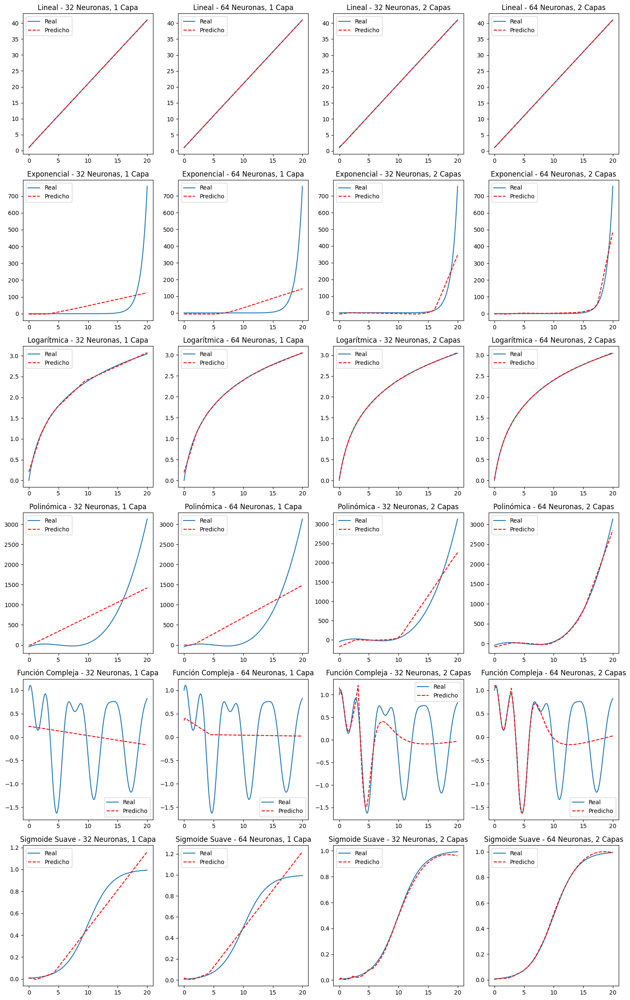

In [36]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt


# Crear una red neuronal simple con una capa densa
def create_model(input_dim, neurons=64, layers=1):
    model = tf.keras.Sequential()
   
    # Añadir la primera capa densa
    model.add(tf.keras.layers.Dense(neurons, activation='relu', input_dim=input_dim))
   
    # Si se quiere una red con más de una capa, añadir más capas densas
    for _ in range(layers - 1):
        model.add(tf.keras.layers.Dense(units=neurons, activation='swish'))
   
    model.add(tf.keras.layers.Dense(1))  # Capa de salida
    model.compile(optimizer='adam', loss='mse')
    return model


# Funciones a ajustar
def linear_function(x):
    return 2 * x + 1


def exponential_function(x):
    # Evitar la operación que causa el overflow
    return np.exp(x) / (x.shape[0] ** 2)


def logarithmic_function(x):
    return np.log(x + 1)


def polynomial_function(x):
    return (x-5)*(x-1)*(x-9)


def complex_function(x):
    return np.sin(x) + np.exp(-0.1 * x) * np.cos(2 * x)

def smooth_sigmoid_function(x):
    return 1 / (1 + np.exp(-0.5 * (x - 10)))  # Sigmoide desplazado y suavizado



# Datos de entrada
n_datos = 800
X = np.linspace(0, 20, n_datos)  # puntos
X = X.reshape(-1, 1)  # Ajustar la forma para el modelo (800, 1)


# Funciones a ajustar (con la nueva función compleja añadida)
functions = {
    'Lineal': linear_function(X),
    'Exponencial': exponential_function(X),
    'Logarítmica': logarithmic_function(X),
    'Polinómica': polynomial_function(X),
    'Función Compleja': complex_function(X),
    'Sigmoide Suave': smooth_sigmoid_function(X)
}


# Crear una matriz de subgráficos de 5 filas y 4 columnas
fig, ax = plt.subplots(6, 4, figsize=(15, 24))  # 5 filas y 4 columnas


# Configuraciones de los modelos
model_configs = [
    {"neurons": 32, "layers": 1, "label": "32 Neuronas, 1 Capa"},
    {"neurons": 64, "layers": 1, "label": "64 Neuronas, 1 Capa"},
    {"neurons": 32, "layers": 2, "label": "32 Neuronas, 2 Capas"},
    {"neurons": 64, "layers": 2, "label": "64 Neuronas, 2 Capas"}
]


# Entrenar el modelo y graficar los resultados
for i, (func_name, y) in enumerate(functions.items()):
    y = y.reshape(-1, 1)  # Ajustar la forma para la salida
   
    for j, config in enumerate(model_configs):
        # Crear el modelo
        model = create_model(input_dim=1, neurons=config["neurons"], layers=config["layers"])
       
        # Entrenar el modelo
        model.fit(X, y, epochs=200, verbose=0)  # no mostrar nada
       
        # Predecir con el modelo entrenado
        y_pred = model.predict(X)
       
        # Graficar los resultados
        ax[i, j].plot(X, y, label='Real')
        ax[i, j].plot(X, y_pred, color='red', linestyle='dashed', label='Predicho')
        ax[i, j].set_title(f'{func_name} - {config["label"]}')
        ax[i, j].legend()


# Ajustar el espaciado entre los subgráficos para evitar solapamientos
plt.tight_layout()


# Mostrar la figura
plt.show()

In [33]:
import numpy as np
import tensorflow as tf
import plotly.graph_objects as go
from tensorflow.keras import regularizers


# Crear una red neuronal simple con dos entradas (x, y)
def create_model(input_dim=2, neurons=64, layers=2, l2_reg=0.01, dropout_rate=0.15):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Input(shape=(input_dim,)))
    
    # Capa densa con regularización L2
    model.add(tf.keras.layers.Dense(neurons, activation='relu', 
                                    kernel_regularizer=regularizers.l2(l2_reg)))
    
    # Agregar capas ocultas con regularización L2 y Dropout
    for _ in range(layers - 1):
        model.add(tf.keras.layers.Dense(units=neurons, activation='swish',
                                        kernel_regularizer=regularizers.l2(l2_reg)))
        model.add(tf.keras.layers.Dropout(dropout_rate))  # Dropout para evitar sobreajuste
    
    model.add(tf.keras.layers.Dense(1))  # Capa de salida
    model.compile(optimizer='adam', loss='mse')
    return model

def polynomial_function(X):
    x, y = X[:, 0], X[:, 1]
    return (x - 5)*(x - 4)*(x - 15) + (y - 6)*(y - 7)*(y - 19)

# Crear una malla 2D para los datos de entrada (x, y)
n_points = 40  # Reducido para mejorar visualización
x = np.linspace(-5, 25, n_points)
y = np.linspace(-5, 25, n_points)
X, Y = np.meshgrid(x, y)
X_flat = X.flatten()
Y_flat = Y.flatten()
X_input = np.column_stack((X_flat, Y_flat))  # Datos de entrada (x, y)

# Funciones a ajustar en 3D
functions = {
    'Polinómica': polynomial_function(X_input)
}

# Configuraciones de los modelos
model_configs = [
    {"neurons": 32, "layers": 1, "color": "red", "label": "32 Neuronas, 1 Capa"},
    {"neurons": 64, "layers": 1, "color": "green", "label": "64 Neuronas, 1 Capa"},
    {"neurons": 32, "layers": 2, "color": "purple", "label": "32 Neuronas, 2 Capas"},
    {"neurons": 64, "layers": 2, "color": "orange", "label": "64 Neuronas, 2 Capas"},
    {"neurons": 128, "layers": 6, "color": "orange", "label": "128 Neuronas, 4 Capas"}
]

# Iterar sobre cada función y graficar individualmente con los 4 modelos
for func_name, y in functions.items():
    y = y.reshape(-1, 1)  # Ajustar la forma para la salida

    # Iterar sobre cada modelo
    for config in model_configs:
        fig = go.Figure()

        # Generar una matriz de valores constantes (el color fijo para la superficie)
        surface_color_real = np.full_like(y, fill_value=0.7)  # El color de la superficie real (gris)

        # Agregar la superficie real con color sólido (usamos valores numéricos)
        fig.add_trace(go.Surface(
            z=y.reshape(X.shape), x=X, y=Y, colorscale=[[0, 'rgb(255,0,0)'], [1, 'rgb(255,0,0)']], opacity=1, 
            name="Superficie Real", showscale=False
        ))
        # Crear y entrenar el modelo con regularización L2
        model = create_model(input_dim=2, neurons=config["neurons"], layers=config["layers"], l2_reg=0.01, dropout_rate=0.2)
        model.fit(X_input, y, epochs=120, verbose=0)
        
        # Predecir valores
        y_pred = model.predict(X_input).flatten()
        # Calcular el MAPE
        mape = np.mean(np.abs((y.flatten() - y_pred) / (y.flatten()))) * 100
        print(f"MAPE para {config['label']}: {mape:2f}%")
        # Asignar un color constante por modelo usando valores numéricos
        if config["color"] == "red":
            surface_color_pred = np.full_like(y_pred, fill_value=1.0)  # Color rojo (valor 1.0)
        elif config["color"] == "green":
            surface_color_pred = np.full_like(y_pred, fill_value=0.5)  # Color verde (valor 0.5)
        elif config["color"] == "purple":
            surface_color_pred = np.full_like(y_pred, fill_value=0.3)  # Color púrpura (valor 0.3)
        else:
            surface_color_pred = np.full_like(y_pred, fill_value=0.0)  # Color naranja (valor 0.0)

        # Graficar la predicción del modelo con un color fijo
        fig.add_trace(go.Surface(
            z=y_pred.reshape(X.shape), x=X, y=Y,
            surfacecolor=surface_color_pred, opacity=0.6, name=config["label"], showscale=False
        ))
        
        fig.show()

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 904us/step
MAPE para 32 Neuronas, 1 Capa: 394.276464%


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 878us/step
MAPE para 64 Neuronas, 1 Capa: 354.478177%


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
MAPE para 32 Neuronas, 2 Capas: 355.655376%


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 959us/step
MAPE para 64 Neuronas, 2 Capas: 239.095411%


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MAPE para 128 Neuronas, 4 Capas: 47.693676%


In [34]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, InputLayer
from tensorflow.keras.optimizers import SGD

In [35]:
# Crear el modelo secuencial
model = Sequential()

# Capa de entrada
model.add(InputLayer(input_shape=(28, 28, 1)))

# Aplanar la imagen 28x28 a un vector de 784 elementos
model.add(Flatten())

# Capa oculta con 15 neuronas y activación ReLU
model.add(Dense(15, activation='relu'))

# Capa de salida con 10 neuronas (para clasificación en 10 clases) y activación softmax
model.add(Dense(10, activation='softmax'))

# Mostrar resumen del modelo
model.summary()

c:\Users\pablo\OneDrive\Documentos\PABLO\Python\PabloPythonRepository\TFG\TFG Project\venv\lib\site-packages\keras\src\layers\core\input_layer.py:27: UserWarning:

Argument `input_shape` is deprecated. Use `shape` instead.



Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 784)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 15)             │        11,775 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 10)             │           160 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,935 (46.62 KB)

 Trainable params: 11,935 (46.62 KB)

 Non-trainable params: 0 (0.00 B)

In [36]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential # type: ignore
from tensorflow.keras.layers import Dense, InputLayer # type: ignore
from tensorflow.keras.optimizers import SGD # type: ignore

# Datos de entrada (x) y salida (y) con la fórmula y = 4 * x - 1
x = np.array([[1], [3], [4], [5]], dtype=float)
y = np.array([[4 * i - 1] for i in x], dtype=float)  

In [37]:
# Crear el modelo secuencial
model = Sequential()

model.add(InputLayer(input_shape=(1,)))  # Capa de entrada (1 característica)
model.add(Dense(10, activation='relu'))  # Capa intermedia con 10 neuronas y activación ReLU

# Capa de salida con una neurona y activación lineal
model.add(Dense(1, activation='linear'))# Capa densa final

In [38]:
model.summary()  # Ver el resumen del modelo

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_21 (Dense)                │ (None, 10)             │            20 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 31 (124.00 B)

 Trainable params: 31 (124.00 B)

 Non-trainable params: 0 (0.00 B)

In [39]:
# Compilar el modelo con el optimizador SGD y la pérdida MSE (error cuadrático medio)
model.compile(optimizer=SGD(), loss='mean_squared_error')

In [40]:
# Entrenar el modelo con los datos x y y
model.fit(x, y, epochs=400, verbose=1)

Epoch 1/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - loss: 178.0514
Epoch 2/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 34.4395
Epoch 3/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 4.2045
Epoch 4/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 4.6933
Epoch 5/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - loss: 2.9827
Epoch 6/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 3.2107
Epoch 7/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 2.2591
Epoch 8/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 2.3703
Epoch 9/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 1.7820
Epoch 10/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 1.8345
Epoch 11/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 1.4464
Epoch 12/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - loss: 1.4678
Epoch 13/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 1.2000
Epoch 14/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - loss: 1.2044
Epoch 15/400
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - loss: 1.0130
Epoch 16/400
1/

In [41]:
# Evaluar el modelo con los datos de entrenamiento (esto da la pérdida)
loss = model.evaluate(x, y)
loss

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step - loss: 0.0201


0.02012268267571926

In [42]:
predictions = model.predict(np.array([2]))
predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


array([[7.08]], dtype=float32)

# Optimizadores

In [44]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import torch
import time

Ejecutando optimizador: SGD (implementación interna: SGD) con lr=0.01, momentum=0.0
Ejecutando optimizador: SGD con Momentum (implementación interna: SGD_momentum) con lr=0.01, momentum=0.9
Ejecutando optimizador: RMSprop (implementación interna: RMSprop) con lr=0.01, momentum=0.0
Ejecutando optimizador: Adam (implementación interna: Adam) con lr=0.01, momentum=0.0


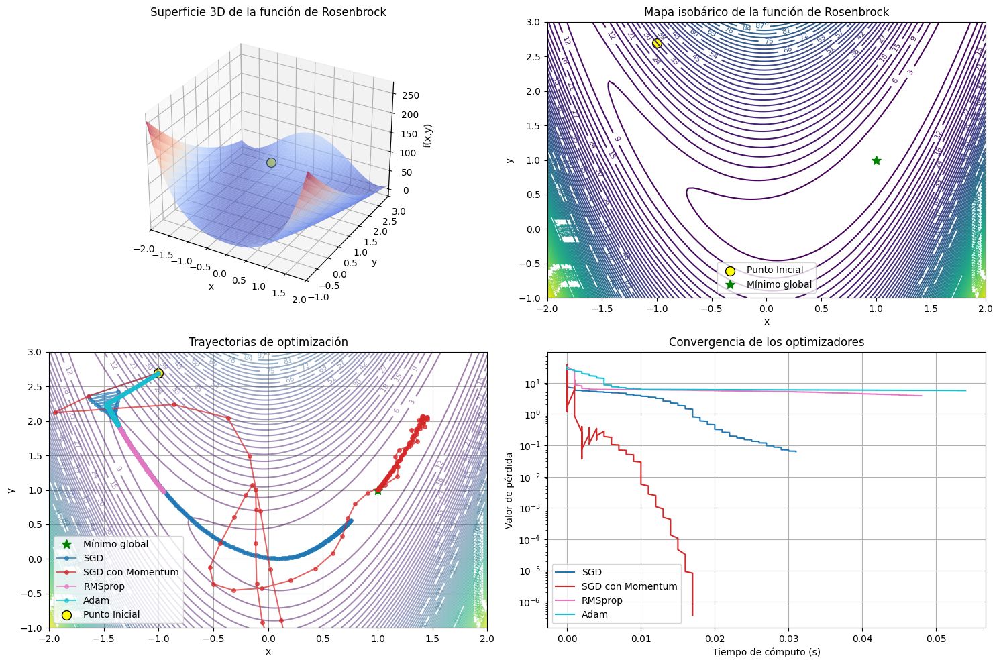

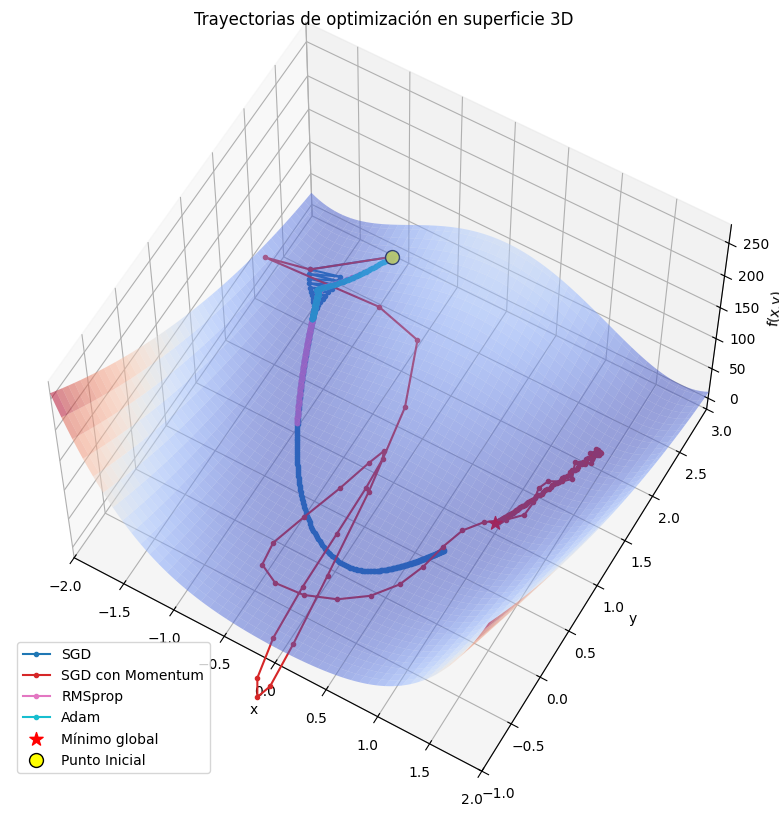

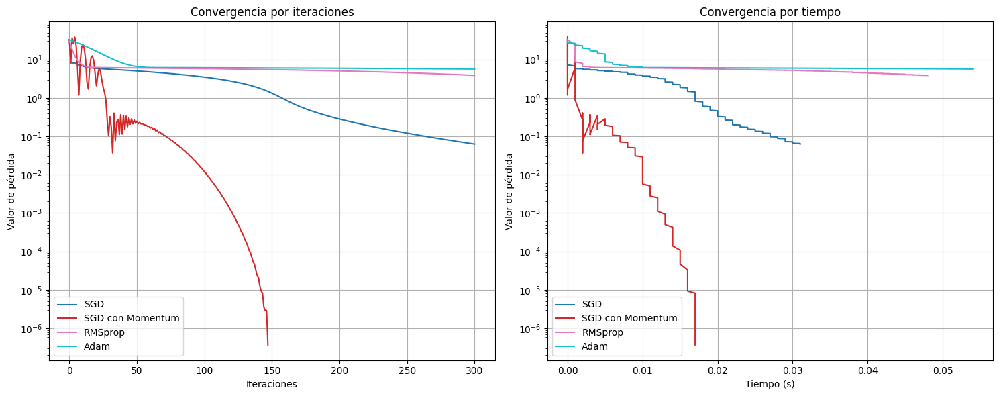


Resumen de resultados (SGD, Momentum SGD, RMSprop, Adam):
--------------------------------------------------------------------------------
Optimizador          Pérdida final   Iteraciones     Tiempo total (s) Convergencia   
--------------------------------------------------------------------------------
SGD                  0.062774        300             0.031006        Buena          
  Punto final: (0.7521, 0.5541), Distancia al mínimo: 0.510120
SGD con Momentum     0.000000        147             0.017005        Excelente      
  Punto final: (1.0006, 1.0010), Distancia al mínimo: 0.001176
RMSprop              3.865686        300             0.047991        Pobre          
  Punto final: (-0.9533, 0.9797), Distancia al mínimo: 1.953384
Adam                 5.658091        300             0.054000        Pobre          
  Punto final: (-1.3690, 1.9419), Distancia al mínimo: 2.549380

Clasificación por rendimiento (SGD, Momentum SGD, RMSprop, Adam):
--------------------------------

In [ ]:
def compare_optimizers(optimizers_list=None, learning_rates=None, max_iterations=80,
                      save_figures=True, output_prefix="optimizer_comparison",
                      show_plots=True, initial_point=(0.0, 1.0),
                      rosenbrock_a=1, rosenbrock_b=10,
                      x_limits=(-2, 2), y_limits=(-1, 3),
                      contour_levels=170):
    """
    Compara el rendimiento de diferentes optimizadores de PyTorch en la función de Rosenbrock.

    Parámetros:
    -----------
    optimizers_list : list, opcional
        Lista de nombres de optimizadores a comparar. Por defecto, usa todos los optimizadores disponibles.
    learning_rates : dict, opcional
        Diccionario con tasas de aprendizaje específicas para cada optimizador.
        Por ejemplo: {'Adam': 0.01, 'SGD': 0.1}
    max_iterations : int, opcional
        Número máximo de iteraciones para cada optimizador. Por defecto es 80.
    save_figures : bool, opcional
        Si es True, guarda las figuras generadas. Por defecto es True.
    output_prefix : str, opcional
        Prefijo para los nombres de los archivos guardados. Por defecto es "optimizer_comparison".
    show_plots : bool, opcional
        Si es True, muestra las figuras. Por defecto es True.
    initial_point : tuple, opcional
        Punto inicial (x, y) para la optimización. Por defecto es (0.0, 1.0).
    rosenbrock_a : float, opcional
        Parámetro 'a' de la función de Rosenbrock. Por defecto es 1.
    rosenbrock_b : float, opcional
        Parámetro 'b' de la función de Rosenbrock. Por defecto es 10.
    x_limits : tuple, opcional
        Límites (min, max) para el eje x en las visualizaciones. Por defecto es (-2, 2).
    y_limits : tuple, opcional
        Límites (min, max) para el eje y en las visualizaciones. Por defecto es (-1, 3).
    contour_levels : int, opcional
        Número de niveles para el mapa isobárico. Por defecto es 170.

    Returns:
    --------
    dict
        Diccionario con los resultados de la optimización para cada optimizador.
    """
    # Configuración para reproducibilidad
    np.random.seed(42)
    torch.manual_seed(42)

    # Si no se especifica la lista de optimizadores, usar todos los disponibles
    if optimizers_list is None:
        optimizers_list = ["SGD", "Adam", "RMSprop", "AdamW", "Adagrad", "Adadelta", "Adamax", "Nadam"]

    # Si no se especifican tasas de aprendizaje, usar valores predeterminados
    if learning_rates is None:
        learning_rates = {
            "SGD": 0.01,
            "Adam": 0.01,
            "RMSprop": 0.01,
            "AdamW": 0.01,
            "Adagrad": 0.5,
            "Adadelta": 1.0,
            "Adamax": 0.01,
            "Nadam": 0.01
        }

    # Definir una función de prueba en 3D (Función de Rosenbrock modificada para evitar desbordamiento)
    def rosenbrock(x, y, a=rosenbrock_a, b=rosenbrock_b):
        # Utilizamos np.clip para limitar los valores y evitar desbordamientos
        if isinstance(x, np.ndarray) and isinstance(y, np.ndarray):
            x_clipped = np.clip(x, -15, 15)
            y_clipped = np.clip(y, -15, 15)
        else:
            x_clipped = max(min(float(x), 15), -15)
            y_clipped = max(min(float(y), 15), -15)

        return ((a - x_clipped)**2 + b * (y_clipped - x_clipped**2)**2)

    # Derivadas parciales para la función de Rosenbrock
    def grad_rosenbrock(x, y, a=rosenbrock_a, b=rosenbrock_b):
        # Limitar valores para evitar desbordamientos
        x_val = max(min(float(x), 15), -15)
        y_val = max(min(float(y), 15), -15)

        dx = -2 * (a - x_val) - 4 * b * x_val * (y_val - x_val**2)
        dy = 2 * b * (y_val - x_val**2)

        # Limitar los gradientes para evitar explosiones
        dx = max(min(dx, 1000), -1000)
        dy = max(min(dy, 1000), -1000)

        return torch.tensor([dx, dy],dtype=torch.float)

    # Crear superficie 3D para visualización
    def create_surface():
        x = np.linspace(x_limits[0], x_limits[1], 100)
        y = np.linspace(y_limits[0], y_limits[1], 100)
        X, Y = np.meshgrid(x, y)
        Z = rosenbrock(X, Y)

        # Limitar Z para evitar valores extremos
        Z = np.clip(Z, 0, 1000)

        return X, Y, Z

    # Clase para implementar los diferentes optimizadores
    class OptimizationTracker:
        def __init__(self, optimizer_name, learning_rate=0.01, momentum=0.0, max_iters=100):
            self.optimizer_name = optimizer_name
            self.learning_rate = learning_rate
            self.momentum = momentum
            self.max_iters = max_iters
            self.trajectory = []
            self.loss_history = []
            self.time_history = []

            # Punto inicial
            self.current_point = torch.tensor([float(initial_point[0]), float(initial_point[1])], requires_grad=True)
            self.optimizer = None
            self._configure_optimizer()

            # Guardar el punto inicial
            self.trajectory.append(self.current_point.detach().numpy().copy())
            initial_loss = rosenbrock(self.current_point[0].item(), self.current_point[1].item())
            self.loss_history.append(initial_loss)
            self.time_history.append(0)

        def _configure_optimizer(self):
            if self.optimizer_name == "SGD":
                self.optimizer = torch.optim.SGD([self.current_point], lr=self.learning_rate)
            elif self.optimizer_name == "SGD_momentum":
                self.optimizer = torch.optim.SGD([self.current_point], lr=self.learning_rate, momentum=self.momentum)
            elif self.optimizer_name == "RMSprop":
                self.optimizer = torch.optim.RMSprop([self.current_point], lr=self.learning_rate)
            elif self.optimizer_name == "Adam":
                self.optimizer = torch.optim.Adam([self.current_point], lr=self.learning_rate)
            else:
                raise ValueError(f"Optimizador {self.optimizer_name} no soportado")

        def step(self):
            # Medir el tiempo de inicio
            start_time = time.time()

            # Calcular el gradiente
            x, y = self.current_point
            grad = grad_rosenbrock(x, y)

            # Aplicar el gradiente manualmente
            self.current_point.grad = grad

            # Paso del optimizador
            self.optimizer.step()
            self.optimizer.zero_grad()

            # Medir el tiempo transcurrido
            elapsed = time.time() - start_time

            # Registrar la trayectoria y la pérdida
            self.trajectory.append(self.current_point.detach().numpy().copy())
            current_loss = rosenbrock(self.current_point[0].item(), self.current_point[1].item())
            self.loss_history.append(current_loss)

            # Acumular el tiempo
            last_time = self.time_history[-1]
            self.time_history.append(last_time + elapsed)

            return current_loss

        def optimize(self):
            for _ in range(self.max_iters):
                loss = self.step()
                if loss < 1e-6:
                    break

    # Colores para los gráficos
    colors = plt.cm.tab10(np.linspace(0, 1, 4))
    optimizer_names = ["SGD", "SGD con Momentum", "RMSprop", "Adam"]

    # Crear la superficie 3D
    X, Y, Z = create_surface()

    # Ejecutar los optimizadores
    trackers = []
    learning_rates_subset = {"SGD": 0.01, "SGD_momentum": 0.01, "RMSprop": 0.01, "Adam": 0.01}
    momentums = {"SGD_momentum": 0.9}

    for i, opt_name_base in enumerate(optimizer_names):
        opt_name = opt_name_base.replace(" con Momentum", "_momentum")
        lr = learning_rates_subset.get(opt_name, 0.01)
        momentum = momentums.get(opt_name, 0.0)

        print(f"Ejecutando optimizador: {opt_name_base} (implementación interna: {opt_name}) con lr={lr}, momentum={momentum}")
        tracker = OptimizationTracker(opt_name, learning_rate=lr, momentum=momentum, max_iters=max_iterations)
        tracker.optimize()
        trackers.append(tracker)

    # ===== GRÁFICOS PRINCIPALES PARA LOS 4 OPTIMIZADORES =====
    if show_plots or save_figures:
        # Crear la figura para los gráficos principales
        fig = plt.figure(figsize=(15, 10))

        # 1. Gráfico de superficie 3D
        ax1 = fig.add_subplot(221, projection='3d')
        surf = ax1.plot_surface(X, Y, Z, cmap=cm.coolwarm, alpha=0.6, linewidth=0, antialiased=True)
        ax1.set_xlabel('x')
        ax1.set_ylabel('y')
        ax1.set_zlabel('f(x,y)')
        ax1.set_title('Superficie 3D de la función de Rosenbrock')
        ax1.set_xlim(x_limits)
        ax1.set_ylim(y_limits)
        ax1.scatter(initial_point[0], initial_point[1],
            facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')

        # 2. Mapa isobárico (contornos con etiquetas)
        ax2 = fig.add_subplot(222)
        contours = ax2.contour(X, Y, Z, levels=contour_levels, cmap='viridis')
        ax2.scatter(initial_point[0], initial_point[1],
            facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')
        ax2.clabel(contours, inline=True, fontsize=8)
        ax2.set_xlabel('x')
        ax2.set_ylabel('y')
        ax2.set_title('Mapa isobárico de la función de Rosenbrock')
        ax2.plot(rosenbrock_a, rosenbrock_a**2, 'g*', markersize=10, label='Mínimo global')
        ax2.legend()
        ax2.set_xlim(x_limits)
        ax2.set_ylim(y_limits)

        # 3. Gráfico de trayectorias 2D con contornos
        ax3 = fig.add_subplot(223)
        contours = ax3.contour(X, Y, Z, levels=contour_levels, cmap='viridis', alpha=0.5)
        ax3.clabel(contours, inline=True, fontsize=8)
        ax3.set_xlabel('x')
        ax3.set_ylabel('y')
        ax3.set_title('Trayectorias de optimización')
        ax3.plot(rosenbrock_a, rosenbrock_a**2, 'g*', markersize=10, label='Mínimo global')

        for i, tracker in enumerate(trackers):
            trajectory = np.array(tracker.trajectory)
            ax3.plot(trajectory[:, 0], trajectory[:, 1], 'o-', label=optimizer_names[i],
                     color=colors[i], markersize=4, alpha=0.7)

        ax3.scatter(initial_point[0], initial_point[1],
             facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')
        ax3.legend(loc='lower left')
        ax3.grid(True)
        ax3.set_xlim(x_limits)
        ax3.set_ylim(y_limits)

        # 4. Gráfico de convergencia
        ax4 = fig.add_subplot(224)
        for i, tracker in enumerate(trackers):
            ax4.plot(tracker.time_history, tracker.loss_history, '-',
                     label=optimizer_names[i], color=colors[i])
        ax4.set_xlabel('Tiempo de cómputo (s)')
        ax4.set_ylabel('Valor de pérdida')
        ax4.set_title('Convergencia de los optimizadores')
        ax4.set_yscale('log')
        ax4.grid(True)
        ax4.legend()

        plt.tight_layout()
        if save_figures:
            plt.savefig(f'{output_prefix}_subset_principal.png', dpi=200)
        if show_plots:
            plt.show()
        else:
            plt.close()

        # ===== GRÁFICO ADICIONAL: TRAYECTORIAS 3D PARA LOS 4 OPTIMIZADORES =====
        fig2 = plt.figure(figsize=(10, 8))
        ax3d = fig2.add_subplot(111, projection='3d')
        surf = ax3d.plot_surface(X, Y, Z, cmap=cm.coolwarm, alpha=0.5, linewidth=0, antialiased=True)
        ax3d.view_init(elev=60, azim=300)

        # Graficar trayectorias 3D
        for i, tracker in enumerate(trackers):
            trajectory = np.array(tracker.trajectory)
            z_vals = [rosenbrock(x, y) for x, y in trajectory]
            ax3d.plot(trajectory[:, 0], trajectory[:, 1], z_vals, 'o-',
                      label=optimizer_names[i], color=colors[i], markersize=3)

        # Marcar el mínimo global
        ax3d.scatter([rosenbrock_a], [rosenbrock_a**2], [0], color='red', marker='*', s=100, label='Mínimo global')
        ax3d.scatter(initial_point[0], initial_point[1], rosenbrock(initial_point[0], initial_point[1]),
             facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')

        ax3d.set_xlabel('x')
        ax3d.set_ylabel('y')
        ax3d.set_zlabel('f(x,y)')
        ax3d.set_title('Trayectorias de optimización en superficie 3D')
        ax3d.legend(loc='lower left')
        ax3d.set_xlim(x_limits)
        ax3d.set_ylim(y_limits)

        plt.tight_layout()
        if save_figures:
            plt.savefig(f'{output_prefix}_subset_trayectorias_3d.png', dpi=200)
        if show_plots:
            plt.show()
        else:
            plt.close()

        # ===== GRÁFICO ADICIONAL: COMPARACIÓN DETALLADA PARA LOS 4 OPTIMIZADORES =====
        fig3, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

        # Gráfico de pérdida vs iteraciones
        for i, tracker in enumerate(trackers):
            iterations = range(len(tracker.loss_history))
            ax1.plot(iterations, tracker.loss_history, '-',
                     label=optimizer_names[i], color=colors[i])
        ax1.set_xlabel('Iteraciones')
        ax1.set_ylabel('Valor de pérdida')
        ax1.set_title('Convergencia por iteraciones')
        ax1.set_yscale('log')
        ax1.grid(True)
        ax1.legend()

        # Gráfico de pérdida vs tiempo
        for i, tracker in enumerate(trackers):
            ax2.plot(tracker.time_history, tracker.loss_history, '-',
                     label=optimizer_names[i], color=colors[i])
        ax2.set_xlabel('Tiempo (s)')
        ax2.set_ylabel('Valor de pérdida')
        ax2.set_title('Convergencia por tiempo')
        ax2.set_yscale('log')
        ax2.grid(True)
        ax2.legend()

        plt.tight_layout()
        if save_figures:
            plt.savefig(f'{output_prefix}_subset_comparacion_detallada.png', dpi=200)
        if show_plots:
            plt.show()
        else:
            plt.close()

    # Calcular el punto mínimo teórico
    min_point = (rosenbrock_a, rosenbrock_a**2)

    # Preparar resultados para el retorno
    results = {}
    print("\nResumen de resultados (SGD, Momentum SGD, RMSprop, Adam):")
    print("-" * 80)
    print(f"{'Optimizador':<20} {'Pérdida final':<15} {'Iteraciones':<15} {'Tiempo total (s)':<15} {'Convergencia':<15}")
    print("-" * 80)

    for i, tracker in enumerate(trackers):
        iterations = len(tracker.trajectory) - 1
        final_loss = tracker.loss_history[-1]
        total_time = tracker.time_history[-1]
        final_point = tracker.trajectory[-1]
        opt_name_display = optimizer_names[i]

        # Evaluar la convergencia
        if final_loss < 1e-3:
            convergence = "Excelente"
        elif final_loss < 1e-1:
            convergence = "Buena"
        elif final_loss < 1:
            convergence = "Regular"
        else:
            convergence = "Pobre"

        print(f"{opt_name_display:<20} {final_loss:<15.6f} {iterations:<15} {total_time:<15.6f} {convergence:<15}")
        print(f"  Punto final: ({final_point[0]:.4f}, {final_point[1]:.4f}), Distancia al mínimo: {np.sqrt((final_point[0]-min_point[0])**2 + (final_point[1]-min_point[1])**2):.6f}")

        # Guardar los resultados
        results[opt_name_display] = {
            'final_loss': final_loss,
            'iterations': iterations,
            'total_time': total_time,
            'final_point': final_point,
            'convergence': convergence,
            'distance_to_minimum': np.sqrt((final_point[0]-min_point[0])**2 + (final_point[1]-min_point[1])**2),
            'trajectory': tracker.trajectory,
            'loss_history': tracker.loss_history,
            'time_history': tracker.time_history
        }

    # Crear una tabla de clasificación
    print("\nClasificación por rendimiento (SGD, Momentum SGD, RMSprop, Adam):")
    print("-" * 80)

    # Ordenar optimizadores por pérdida final
    sorted_by_loss = sorted(zip(optimizer_names, trackers), key=lambda x: x[1].loss_history[-1])
    print("Por precisión (menor pérdida):")
    for i, (name, tracker) in enumerate(sorted_by_loss):
        print(f"{i+1}. {name}: {tracker.loss_history[-1]:.6f}")

    # Ordenar optimizadores por velocidad (tiempo)
    sorted_by_time = sorted(zip(optimizer_names, trackers), key=lambda x: x[1].time_history[-1])
    print("\nPor velocidad (menor tiempo):")
    for i, (name, tracker) in enumerate(sorted_by_time):
        print(f"{i+1}. {name}: {tracker.time_history[-1]:.6f}s")

    # Ordenar optimizadores por eficiencia (iteraciones)
    sorted_by_iter = sorted(zip(optimizer_names, trackers), key=lambda x: len(x[1].trajectory))
    print("\nPor eficiencia (menos iteraciones):")
    for i, (name, tracker) in enumerate(sorted_by_iter):
        print(f"{i+1}. {name}: {len(tracker.trajectory)} iteraciones")

    # Rankings como parte de los resultados
    results['rankings'] = {
        'precision': [name for name, tracker in sorted_by_loss],
        'velocidad': [name for name, tracker in sorted_by_time],
        'eficiencia': [name for name, tracker in sorted_by_iter]
    }

    # Agregar metadatos sobre la función y configuración
    results['config'] = {
        'rosenbrock_a': rosenbrock_a,
        'rosenbrock_b': rosenbrock_b,
        'x_limits': x_limits,
        'y_limits': y_limits,
        'min_point': min_point,
        'initial_point': initial_point,
        'contour_levels': contour_levels
    }

    return results

# Ejemplo de uso para SGD, SGD con Momentum, RMSprop y Adam
results_subset = compare_optimizers(
    optimizers_list=["SGD", "SGD_momentum", "RMSprop", "Adam"],
    learning_rates={"SGD": 0.01, "SGD_momentum": 0.01, "RMSprop": 0.01, "Adam": 0.01},
    initial_point=(-1, 2.7),
    max_iterations=300,
    x_limits=(-2, 2),
    y_limits=(-1, 3),
    save_figures=False,
    output_prefix="optimizer_subset_comparison",
    show_plots=True,
    rosenbrock_a=1,
    rosenbrock_b=10,
    contour_levels=100
)

Ejecutando optimizador: SGD con lr=0.01
Ejecutando optimizador: Adam con lr=0.01
Ejecutando optimizador: RMSprop con lr=0.01
Ejecutando optimizador: Adagrad con lr=0.5
Ejecutando optimizador: Adadelta con lr=1.0
Ejecutando optimizador: Adamax con lr=0.01
Ejecutando optimizador: Nadam con lr=0.01


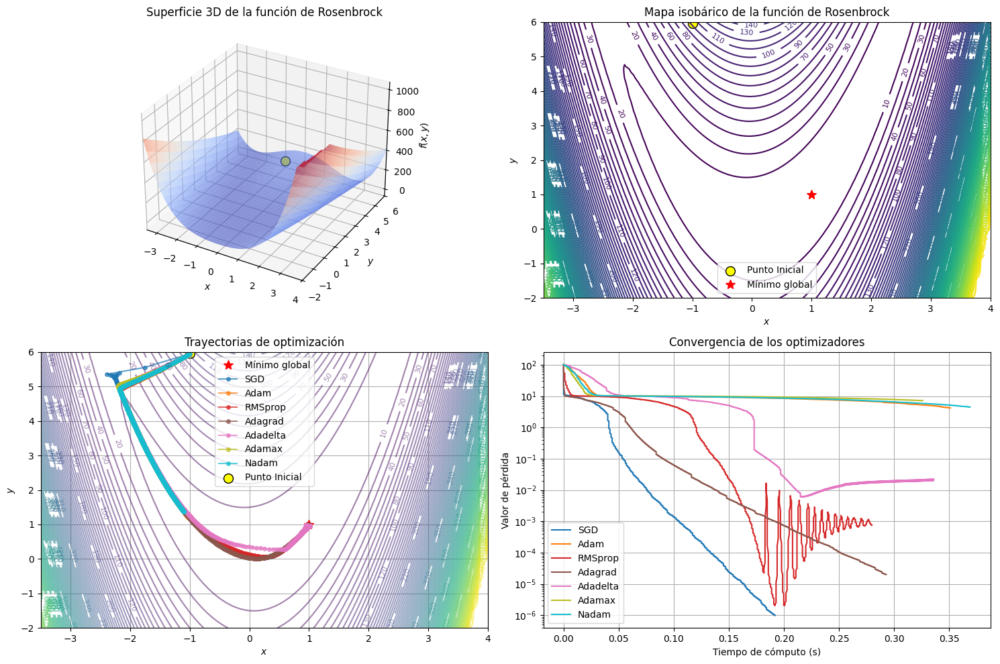

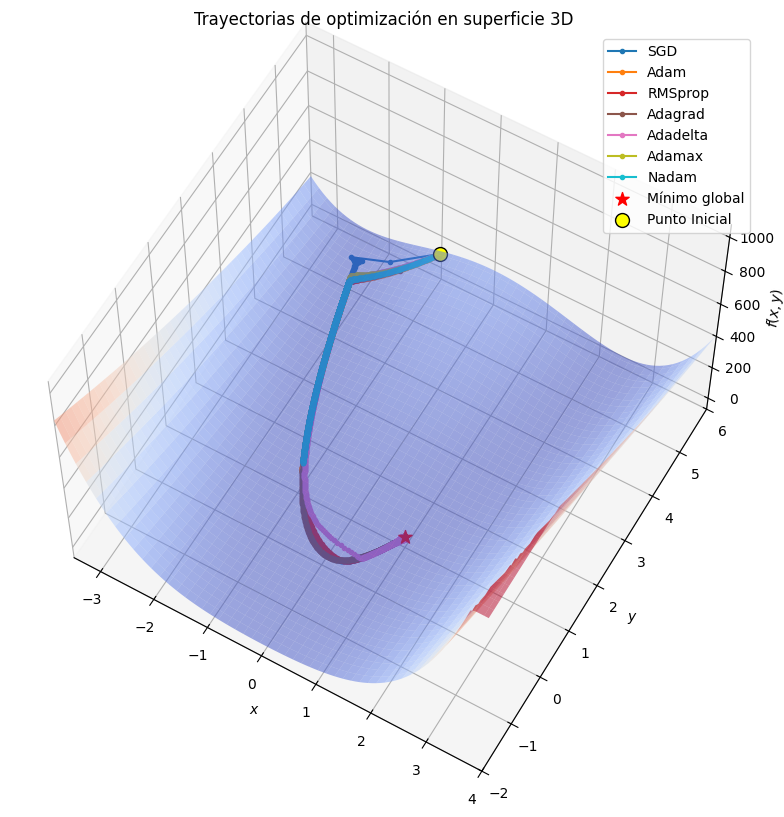

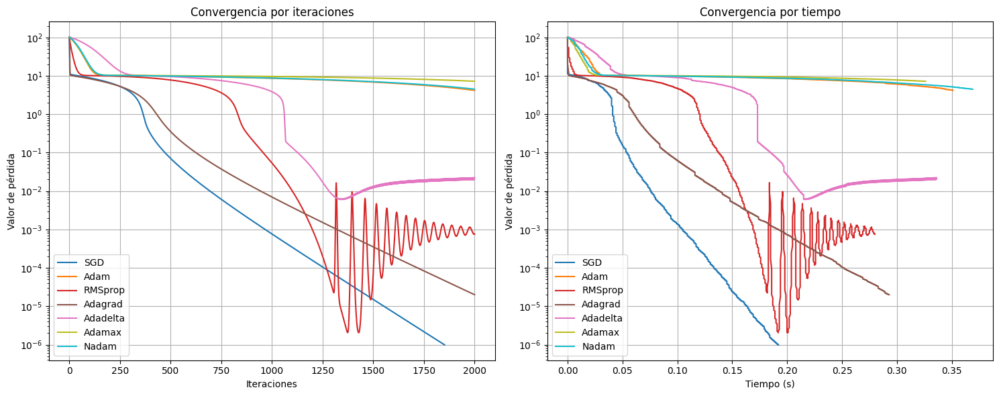


Resumen de resultados:
--------------------------------------------------------------------------------
Optimizador     Pérdida final   Iteraciones     Tiempo total (s) Convergencia   
--------------------------------------------------------------------------------
SGD             0.000001        1852            0.192065        Excelente      
  Punto final: (0.9990, 0.9979), Distancia al mínimo: 0.002271
Adam            4.185227        2000            0.351004        Pobre          
  Punto final: (-1.0216, 1.2005), Distancia al mínimo: 2.031473
RMSprop         0.000755        2000            0.279853        Excelente      
  Punto final: (1.0039, 0.9943), Distancia al mínimo: 0.006929
Adagrad         0.000020        2000            0.292935        Excelente      
  Punto final: (0.9956, 0.9908), Distancia al mínimo: 0.010193
Adadelta        0.022318        2000            0.335996        Buena          
  Punto final: (0.9504, 0.9738), Distancia al mínimo: 0.056099
Adamax          7

In [46]:
def compare_optimizers(optimizers_list=None, learning_rates=None, max_iterations=80, 
                      save_figures=True, output_prefix="optimizer_comparison", 
                      show_plots=True, initial_point=(0.0, 1.0),
                      rosenbrock_a=1, rosenbrock_b=10,
                      x_limits=(-2, 2), y_limits=(-1, 3),
                      contour_levels=170):
    """
    Compara el rendimiento de diferentes optimizadores de PyTorch en la función de Rosenbrock.
    
    Parámetros:
    -----------
    optimizers_list : list, opcional
        Lista de nombres de optimizadores a comparar. Por defecto, usa todos los optimizadores disponibles.
    learning_rates : dict, opcional
        Diccionario con tasas de aprendizaje específicas para cada optimizador. 
        Por ejemplo: {'Adam': 0.01, 'SGD': 0.1}
    max_iterations : int, opcional
        Número máximo de iteraciones para cada optimizador. Por defecto es 80.
    save_figures : bool, opcional
        Si es True, guarda las figuras generadas. Por defecto es True.
    output_prefix : str, opcional
        Prefijo para los nombres de los archivos guardados. Por defecto es "optimizer_comparison".
    show_plots : bool, opcional
        Si es True, muestra las figuras. Por defecto es True.
    initial_point : tuple, opcional
        Punto inicial (x, y) para la optimización. Por defecto es (0.0, 1.0).
    rosenbrock_a : float, opcional
        Parámetro 'a' de la función de Rosenbrock. Por defecto es 1.
    rosenbrock_b : float, opcional
        Parámetro 'b' de la función de Rosenbrock. Por defecto es 10.
    x_limits : tuple, opcional
        Límites (min, max) para el eje x en las visualizaciones. Por defecto es (-2, 2).
    y_limits : tuple, opcional
        Límites (min, max) para el eje y en las visualizaciones. Por defecto es (-1, 3).
    contour_levels : int, opcional
        Número de niveles para el mapa isobárico. Por defecto es 170.
        
    Returns:
    --------
    dict
        Diccionario con los resultados de la optimización para cada optimizador.
    """
    # Configuración para reproducibilidad
    np.random.seed(42)
    torch.manual_seed(42)
    
    # Si no se especifica la lista de optimizadores, usar todos los disponibles
    if optimizers_list is None:
        optimizers_list = ["SGD", "Adam", "RMSprop", "AdamW", "Adagrad", "Adadelta", "Adamax", "Nadam"]
    
    # Si no se especifican tasas de aprendizaje, usar valores predeterminados
    if learning_rates is None:
        learning_rates = {
            "SGD": 0.01,
            "Adam": 0.01,
            "RMSprop": 0.01,
            "AdamW": 0.01,
            "Adagrad": 0.5,
            "Adadelta": 1.0,
            "Adamax": 0.01,
            "Nadam": 0.01
        }
    
    # Definir una función de prueba en 3D (Función de Rosenbrock modificada para evitar desbordamiento)
    def rosenbrock(x, y, a=rosenbrock_a, b=rosenbrock_b):  
        # Utilizamos np.clip para limitar los valores y evitar desbordamientos
        if isinstance(x, np.ndarray) and isinstance(y, np.ndarray):
            x_clipped = np.clip(x, -15, 15)
            y_clipped = np.clip(y, -15, 15)
        else:
            x_clipped = max(min(float(x), 15), -15)
            y_clipped = max(min(float(y), 15), -15)
        
        return ((a - x_clipped)**2 + b * (y_clipped - x_clipped**2)**2)

    # Derivadas parciales para la función de Rosenbrock
    def grad_rosenbrock(x, y, a=rosenbrock_a, b=rosenbrock_b):  
        # Limitar valores para evitar desbordamientos
        x_val = max(min(float(x), 15), -15)
        y_val = max(min(float(y), 15), -15)
        
        dx = -2 * (a - x_val) - 4 * b * x_val * (y_val - x_val**2)
        dy = 2 * b * (y_val - x_val**2)
        
        # Limitar los gradientes para evitar explosiones
        dx = max(min(dx, 1000), -1000)
        dy = max(min(dy, 1000), -1000)
        
        return torch.tensor([dx, dy],dtype=torch.float)

    # Crear superficie 3D para visualización
    def create_surface():
        x = np.linspace(x_limits[0], x_limits[1], 100)
        y = np.linspace(y_limits[0], y_limits[1], 100)
        X, Y = np.meshgrid(x, y)
        Z = rosenbrock(X, Y)
        
        # Limitar Z para evitar valores extremos
        Z = np.clip(Z, 0, 1000)
        
        return X, Y, Z

    # Clase para implementar los diferentes optimizadores
    class OptimizationTracker:
        def __init__(self, optimizer_name, learning_rate=0.01, max_iters=100):
            self.optimizer_name = optimizer_name
            self.learning_rate = learning_rate
            self.max_iters = max_iters
            self.trajectory = []
            self.loss_history = []
            self.time_history = []
            
            # Punto inicial
            self.current_point = torch.tensor([float(initial_point[0]), float(initial_point[1])], requires_grad=True)
            
            # Configurar el optimizador
            if optimizer_name == "SGD":
                self.optimizer = torch.optim.SGD([self.current_point], lr=learning_rate)
            elif optimizer_name == "RMSprop":
                self.optimizer = torch.optim.RMSprop([self.current_point], lr=learning_rate)
            elif optimizer_name == "Adam":
                self.optimizer = torch.optim.Adam([self.current_point], lr=learning_rate)
            elif optimizer_name == "AdamW":
                self.optimizer = torch.optim.AdamW([self.current_point], lr=learning_rate)
            elif optimizer_name == "Adadelta":
                self.optimizer = torch.optim.Adadelta([self.current_point], lr=learning_rate)
            elif optimizer_name == "Adagrad":
                self.optimizer = torch.optim.Adagrad([self.current_point], lr=learning_rate)
            elif optimizer_name == "Adamax":
                self.optimizer = torch.optim.Adamax([self.current_point], lr=learning_rate)
            elif optimizer_name == "Nadam":
                self.optimizer = torch.optim.NAdam([self.current_point], lr=learning_rate)
            else:
                raise ValueError(f"Optimizador {optimizer_name} no soportado")
            
            # Guardar el punto inicial
            self.trajectory.append(self.current_point.detach().numpy().copy())
            initial_loss = rosenbrock(self.current_point[0].item(), self.current_point[1].item())
            self.loss_history.append(initial_loss)
            self.time_history.append(0)
        
        def step(self):
            # Medir el tiempo de inicio
            start_time = time.time()
            
            # Calcular el gradiente
            x, y = self.current_point
            grad = grad_rosenbrock(x, y)
            
            # Aplicar el gradiente manualmente
            self.current_point.grad = grad
            
            # Paso del optimizador
            self.optimizer.step()
            self.optimizer.zero_grad()
            
            # Medir el tiempo transcurrido
            elapsed = time.time() - start_time
            
            # Registrar la trayectoria y la pérdida
            self.trajectory.append(self.current_point.detach().numpy().copy())
            current_loss = rosenbrock(self.current_point[0].item(), self.current_point[1].item())
            self.loss_history.append(current_loss)
            
            # Acumular el tiempo
            last_time = self.time_history[-1]
            self.time_history.append(last_time + elapsed)
            
            return current_loss

        def optimize(self):
            for _ in range(self.max_iters):
                loss = self.step()
                if loss < 1e-6:
                    break

    # Colores para los gráficos
    colors = plt.cm.tab10(np.linspace(0, 1, len(optimizers_list)))

    # Crear la superficie 3D
    X, Y, Z = create_surface()

    # Ejecutar los optimizadores
    trackers = []
    for i, opt_name in enumerate(optimizers_list):
        # Obtener la tasa de aprendizaje para este optimizador
        lr = learning_rates.get(opt_name, 0.01)
        
        print(f"Ejecutando optimizador: {opt_name} con lr={lr}")
        tracker = OptimizationTracker(opt_name, learning_rate=lr, max_iters=max_iterations)
        tracker.optimize()
        trackers.append(tracker)

    # ===== GRÁFICOS PRINCIPALES =====
    if show_plots or save_figures:
        # Crear la figura para los gráficos principales
        fig = plt.figure(figsize=(15, 10))

        # 1. Gráfico de superficie 3D
        ax1 = fig.add_subplot(221, projection='3d')
        surf = ax1.plot_surface(X, Y, Z, cmap=cm.coolwarm, alpha=0.6, linewidth=0, antialiased=True)
        ax1.set_xlabel(r'$x$')
        ax1.set_ylabel(r'$y$')
        ax1.set_zlabel(r'$f(x,y)$')
        ax1.set_title('Superficie 3D de la función de Rosenbrock')
        ax1.set_xlim(x_limits)
        ax1.set_ylim(y_limits)
        ax1.scatter(initial_point[0], initial_point[1], 
            facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')
        # 2. Mapa isobárico (contornos con etiquetas)
        ax2 = fig.add_subplot(222)
        contours = ax2.contour(X, Y, Z, levels=contour_levels, cmap='viridis')
        ax2.scatter(initial_point[0], initial_point[1], 
            facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')
        ax2.clabel(contours, inline=True, fontsize=8)
        ax2.set_xlabel(r'$x$')
        ax2.set_ylabel(r'$y$')
        ax2.set_title('Mapa isobárico de la función de Rosenbrock')
        ax2.plot(rosenbrock_a, rosenbrock_a**2, 'r*', markersize=10, label='Mínimo global')
        ax2.legend()
        ax2.set_xlim(x_limits)
        ax2.set_ylim(y_limits)
        


        # 3. Gráfico de trayectorias 2D con contornos
        ax3 = fig.add_subplot(223)
        contours = ax3.contour(X, Y, Z, levels=contour_levels, cmap='viridis', alpha=0.5)
        ax3.clabel(contours, inline=True, fontsize=8)
        ax3.set_xlabel(r'$x$')
        ax3.set_ylabel(r'$y$')
        ax3.set_title('Trayectorias de optimización')
        ax3.plot(rosenbrock_a, rosenbrock_a**2, 'r*', markersize=10, label='Mínimo global')

        for i, tracker in enumerate(trackers):
            trajectory = np.array(tracker.trajectory)
            ax3.plot(trajectory[:, 0], trajectory[:, 1], 'o-', label=tracker.optimizer_name, 
                     color=colors[i], markersize=4, alpha=0.7)

        ax3.scatter(initial_point[0], initial_point[1], 
             facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')
        ax3.legend()
        ax3.grid(True)
        ax3.set_xlim(x_limits)
        ax3.set_ylim(y_limits)
       

        # 4. Gráfico de convergencia
        ax4 = fig.add_subplot(224)
        for i, tracker in enumerate(trackers):
            ax4.plot(tracker.time_history, tracker.loss_history, '-', 
                     label=tracker.optimizer_name, color=colors[i])
        ax4.set_xlabel('Tiempo de cómputo (s)')
        ax4.set_ylabel('Valor de pérdida')
        ax4.set_title('Convergencia de los optimizadores')
        ax4.set_yscale('log')
        ax4.grid(True)
        ax4.legend()

        plt.tight_layout()
        if save_figures:
            plt.savefig(f'{output_prefix}_principal.png', dpi=200)
        if show_plots:
            plt.show()
        else:
            plt.close()

        # ===== GRÁFICO ADICIONAL: TRAYECTORIAS 3D =====
        fig2 = plt.figure(figsize=(10, 8))
        ax3d = fig2.add_subplot(111, projection='3d')
        surf = ax3d.plot_surface(X, Y, Z, cmap=cm.coolwarm, alpha=0.5, linewidth=0, antialiased=True)
        ax3d.view_init(elev=60, azim=300)

        # Graficar trayectorias 3D
        for i, tracker in enumerate(trackers):
            trajectory = np.array(tracker.trajectory)
            z_vals = [rosenbrock(x, y) for x, y in trajectory]
            ax3d.plot(trajectory[:, 0], trajectory[:, 1], z_vals, 'o-', 
                      label=tracker.optimizer_name, color=colors[i], markersize=3)

        # Marcar el mínimo global
        ax3d.scatter([rosenbrock_a], [rosenbrock_a**2], [0], color='red', marker='*', s=100, label='Mínimo global')
        ax3d.scatter(initial_point[0], initial_point[1], rosenbrock(initial_point[0], initial_point[1]), 
             facecolor='yellow', s=100, marker='o', label="Punto Inicial",edgecolor='black')
             
        ax3d.set_xlabel(r'$x$')
        ax3d.set_ylabel(r'$y$')
        ax3d.set_zlabel(r'$f(x,y)$')
        ax3d.set_title('Trayectorias de optimización en superficie 3D')
        ax3d.legend()
        ax3d.set_xlim(x_limits)
        ax3d.set_ylim(y_limits)

        plt.tight_layout()
        if save_figures:
            plt.savefig(f'{output_prefix}_trayectorias_3d.png', dpi=200)
        if show_plots:
            plt.show()
        else:
            plt.close()

        # ===== GRÁFICO ADICIONAL: COMPARACIÓN DETALLADA =====
        fig3, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

        # Gráfico de pérdida vs iteraciones
        for i, tracker in enumerate(trackers):
            iterations = range(len(tracker.loss_history))
            ax1.plot(iterations, tracker.loss_history, '-', 
                     label=tracker.optimizer_name, color=colors[i])
        ax1.set_xlabel('Iteraciones')
        ax1.set_ylabel('Valor de pérdida')
        ax1.set_title('Convergencia por iteraciones')
        ax1.set_yscale('log')
        ax1.grid(True)
        ax1.legend()

        # Gráfico de pérdida vs tiempo
        for i, tracker in enumerate(trackers):
            ax2.plot(tracker.time_history, tracker.loss_history, '-', 
                     label=tracker.optimizer_name, color=colors[i])
        ax2.set_xlabel('Tiempo (s)')
        ax2.set_ylabel('Valor de pérdida')
        ax2.set_title('Convergencia por tiempo')
        ax2.set_yscale('log')
        ax2.grid(True)
        ax2.legend()

        plt.tight_layout()
        if save_figures:
            plt.savefig(f'{output_prefix}_comparacion_detallada.png', dpi=200)
        if show_plots:
            plt.show()
        else:
            plt.close()

    # Calcular el punto mínimo teórico
    min_point = (rosenbrock_a, rosenbrock_a**2)

    # Preparar resultados para el retorno
    results = {}
    print("\nResumen de resultados:")
    print("-" * 80)
    print(f"{'Optimizador':<15} {'Pérdida final':<15} {'Iteraciones':<15} {'Tiempo total (s)':<15} {'Convergencia':<15}")
    print("-" * 80)

    for tracker in trackers:
        iterations = len(tracker.trajectory) - 1
        final_loss = tracker.loss_history[-1]
        total_time = tracker.time_history[-1]
        final_point = tracker.trajectory[-1]
        
        # Evaluar la convergencia
        if final_loss < 1e-3:
            convergence = "Excelente"
        elif final_loss < 1e-1:
            convergence = "Buena"
        elif final_loss < 1:
            convergence = "Regular"
        else:
            convergence = "Pobre"
            
        print(f"{tracker.optimizer_name:<15} {final_loss:<15.6f} {iterations:<15} {total_time:<15.6f} {convergence:<15}")
        print(f"  Punto final: ({final_point[0]:.4f}, {final_point[1]:.4f}), Distancia al mínimo: {np.sqrt((final_point[0]-min_point[0])**2 + (final_point[1]-min_point[1])**2):.6f}")
        
        # Guardar los resultados
        results[tracker.optimizer_name] = {
            'final_loss': final_loss,
            'iterations': iterations,
            'total_time': total_time,
            'final_point': final_point,
            'convergence': convergence,
            'distance_to_minimum': np.sqrt((final_point[0]-min_point[0])**2 + (final_point[1]-min_point[1])**2),
            'trajectory': tracker.trajectory,
            'loss_history': tracker.loss_history,
            'time_history': tracker.time_history
        }

    # Crear una tabla de clasificación
    print("\nClasificación por rendimiento:")
    print("-" * 80)

    # Ordenar optimizadores por pérdida final
    sorted_by_loss = sorted(trackers, key=lambda x: x.loss_history[-1])
    print("Por precisión (menor pérdida):")
    for i, tracker in enumerate(sorted_by_loss):
        print(f"{i+1}. {tracker.optimizer_name}: {tracker.loss_history[-1]:.6f}")

    # Ordenar optimizadores por velocidad (tiempo)
    sorted_by_time = sorted(trackers, key=lambda x: x.time_history[-1])
    print("\nPor velocidad (menor tiempo):")
    for i, tracker in enumerate(sorted_by_time):
        print(f"{i+1}. {tracker.optimizer_name}: {tracker.time_history[-1]:.6f}s")

    # Ordenar optimizadores por eficiencia (iteraciones)
    sorted_by_iter = sorted(trackers, key=lambda x: len(x.trajectory))
    print("\nPor eficiencia (menos iteraciones):")
    for i, tracker in enumerate(sorted_by_iter):
        print(f"{i+1}. {tracker.optimizer_name}: {len(tracker.trajectory)} iteraciones")
        
    # Rankings como parte de los resultados
    results['rankings'] = {
        'precision': [t.optimizer_name for t in sorted_by_loss],
        'velocidad': [t.optimizer_name for t in sorted_by_time],
        'eficiencia': [t.optimizer_name for t in sorted_by_iter]
    }
    
    # Agregar metadatos sobre la función y configuración
    results['config'] = {
        'rosenbrock_a': rosenbrock_a,
        'rosenbrock_b': rosenbrock_b,
        'x_limits': x_limits,
        'y_limits': y_limits,
        'min_point': min_point,
        'initial_point': initial_point,
        'contour_levels': contour_levels
    }
    
    return results
default=compare_optimizers(
optimizers_list=["SGD", "Adam", "RMSprop", "Adagrad", "Adadelta", "Adamax", "Nadam"],
#learning_rates={"SGD": 0.001, "Adam": 0.001, "RMSprop": 0.001, "Adagrad": 0.001, "Adadelta": 0.001, "Adamax": 0.001, "Nadam": 0.001},
initial_point=(-1, 5.95),
max_iterations=2000,
x_limits=(-3.5, 4),  
y_limits=(-2, 6),  
save_figures=False,
rosenbrock_a=1, 
rosenbrock_b=4,
contour_levels=100
)


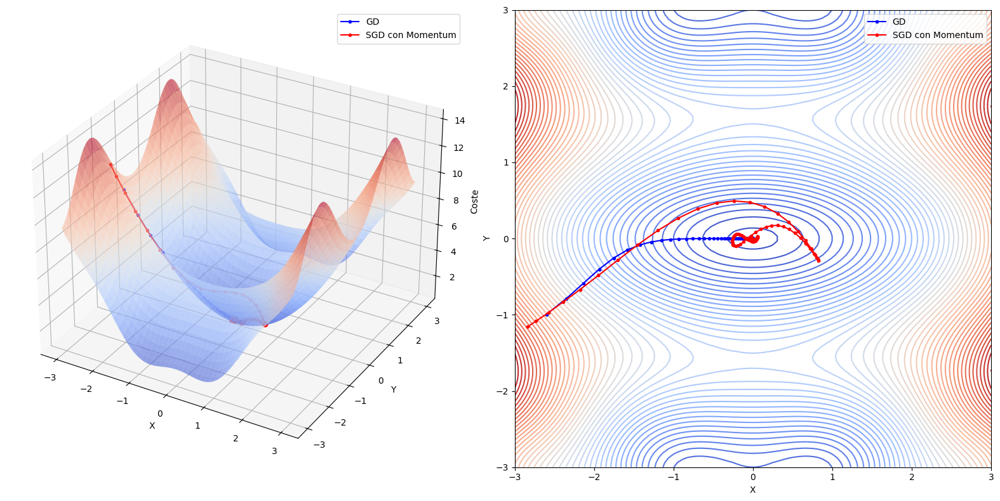

In [48]:
# Definir la función de coste (superficie 3D)
def funcion_coste(x, y):
    return x**2 + 5 * np.sin(y)**2 + 0.1 * y**2 + 0.5 * np.cos(x * y)

# Derivadas parciales
def gradiente_x(x, y):
    return 2 * x - 0.5 * y * np.sin(x * y)

def gradiente_y(x, y):
    return 10 * np.sin(y) * np.cos(y) + 0.2 * y - 0.5 * x * np.sin(x * y)

# Algoritmo de Descenso de Gradiente (GD)
def gd(x_inicio, y_inicio, tasa_aprendizaje, iteraciones):
    trayectoria = []
    x, y = x_inicio, y_inicio
    
    for _ in range(iteraciones):
        grad_x = gradiente_x(x, y)
        grad_y = gradiente_y(x, y)
        
        x = x - tasa_aprendizaje * grad_x
        y = y - tasa_aprendizaje * grad_y
        
        trayectoria.append((x, y, funcion_coste(x, y)))
    
    return np.array(trayectoria)

# Algoritmo de Descenso de Gradiente Estocástico con Momentum (SGD con Momentum)
def sgd_momentum(x_inicio, y_inicio, tasa_aprendizaje, momentum, iteraciones):
    trayectoria = []
    x, y = x_inicio, y_inicio
    velocidad_x, velocidad_y = 0, 0
    
    for i in range(iteraciones):
        # Añadir un poco de ruido para simular el aspecto estocástico
        ruido_x = np.random.normal(0, 0.1)
        ruido_y = np.random.normal(0, 0.1)
        
        grad_x = gradiente_x(x, y) + ruido_x
        grad_y = gradiente_y(x, y) + ruido_y
        
        # Actualizar velocidades con momentum
        velocidad_x = momentum * velocidad_x - tasa_aprendizaje * grad_x
        velocidad_y = momentum * velocidad_y - tasa_aprendizaje * grad_y
        
        # Actualizar posiciones
        x = x + velocidad_x
        y = y + velocidad_y
        
        trayectoria.append((x, y, funcion_coste(x, y)))
    
    return np.array(trayectoria)

# Parámetros
x_inicio, y_inicio = -2.9, -1.2
tasa_aprendizaje_gd = 0.05
tasa_aprendizaje_sgd = 0.01
momentum = 0.9
iteraciones = 100

# Ejecutar algoritmos
trayectoria_gd = gd(x_inicio, y_inicio, tasa_aprendizaje_gd, iteraciones)
trayectoria_sgd = sgd_momentum(x_inicio, y_inicio, tasa_aprendizaje_sgd, momentum, iteraciones)

# Crear malla para la superficie
x = np.linspace(-3, 3, 100)
y = np.linspace(-3, 3, 100)
X, Y = np.meshgrid(x, y)
Z = funcion_coste(X, Y)

# Visualización
fig = plt.figure(figsize=(16, 8))

# Gráfico 1: Superficie 3D con trayectorias
ax1 = fig.add_subplot(121, projection='3d')
superficie = ax1.plot_surface(X, Y, Z, cmap=cm.coolwarm, alpha=0.6)
ax1.plot(trayectoria_gd[:, 0], trayectoria_gd[:, 1], trayectoria_gd[:, 2], 'o-', color='blue', markersize=3, label='GD')
ax1.plot(trayectoria_sgd[:, 0], trayectoria_sgd[:, 1], trayectoria_sgd[:, 2], 'o-', color='red', markersize=3, label='SGD con Momentum')
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Coste')
ax1.legend()

# Gráfico 2: Contorno con trayectorias
ax2 = fig.add_subplot(122)
contorno = ax2.contour(X, Y, Z, 50, cmap=cm.coolwarm)
ax2.plot(trayectoria_gd[:, 0], trayectoria_gd[:, 1], 'o-', color='blue', markersize=3, label='GD')
ax2.plot(trayectoria_sgd[:, 0], trayectoria_sgd[:, 1], 'o-', color='red', markersize=3, label='SGD con Momentum')
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.legend()


plt.tight_layout()
plt.show()

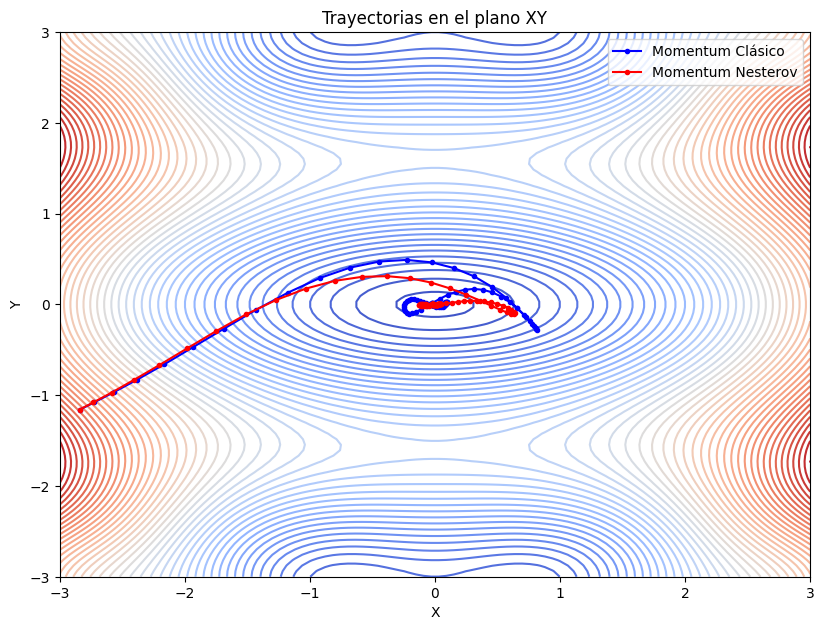

Valor final (Momentum Clásico): 0.500424
Valor final (Momentum Nesterov): 0.500368
Coordenadas finales (Momentum Clásico): (-0.0202, -0.0016)
Coordenadas finales (Momentum Nesterov): (-0.0192, 0.0003)


In [49]:
# Definir la función de coste (superficie 3D)
def funcion_coste(x, y):
    return x**2 + 5 * np.sin(y)**2 + 0.1 * y**2 + 0.5 * np.cos(x * y)

# Derivadas parciales
def gradiente_x(x, y):
    return 2 * x - 0.5 * y * np.sin(x * y)

def gradiente_y(x, y):
    return 10 * np.sin(y) * np.cos(y) + 0.2 * y - 0.5 * x * np.sin(x * y)

# Algoritmo de Descenso de Gradiente Estocástico con Momentum Clásico
def sgd_momentum_clasico(x_inicio, y_inicio, tasa_aprendizaje, momentum, iteraciones):
    trayectoria = []
    x, y = x_inicio, y_inicio
    velocidad_x, velocidad_y = 0, 0
    
    for _ in range(iteraciones):
        # Añadir ruido para simular el aspecto estocástico
        ruido_x = np.random.normal(0, 0.1)
        ruido_y = np.random.normal(0, 0.1)
        
        grad_x = gradiente_x(x, y) + ruido_x
        grad_y = gradiente_y(x, y) + ruido_y
        
        # Actualizar velocidades con momentum clásico
        velocidad_x = momentum * velocidad_x - tasa_aprendizaje * grad_x
        velocidad_y = momentum * velocidad_y - tasa_aprendizaje * grad_y
        
        # Actualizar posiciones
        x = x + velocidad_x
        y = y + velocidad_y
        
        trayectoria.append((x, y, funcion_coste(x, y)))
    
    return np.array(trayectoria)

# Algoritmo de Descenso de Gradiente Estocástico con Momentum de Nesterov
def sgd_momentum_nesterov(x_inicio, y_inicio, tasa_aprendizaje, momentum, iteraciones):
    trayectoria = []
    x, y = x_inicio, y_inicio
    velocidad_x, velocidad_y = 0, 0
    
    for _ in range(iteraciones):
        # Añadir ruido para simular el aspecto estocástico
        ruido_x = np.random.normal(0, 0.1)
        ruido_y = np.random.normal(0, 0.1)
        
        # Look-ahead: calcular gradiente en la posición "futura" según momentum
        x_futuro = x + momentum * velocidad_x
        y_futuro = y + momentum * velocidad_y
        
        grad_x = gradiente_x(x_futuro, y_futuro) + ruido_x
        grad_y = gradiente_y(x_futuro, y_futuro) + ruido_y
        
        # Actualizar velocidades
        velocidad_x = momentum * velocidad_x - tasa_aprendizaje * grad_x
        velocidad_y = momentum * velocidad_y - tasa_aprendizaje * grad_y
        
        # Actualizar posiciones
        x = x + velocidad_x
        y = y + velocidad_y
        
        trayectoria.append((x, y, funcion_coste(x, y)))
    
    return np.array(trayectoria)

# Parámetros
x_inicio, y_inicio = -2.9, -1.2
tasa_aprendizaje = 0.01
momentum = 0.9
iteraciones = 100

# Ejecutar algoritmos
trayectoria_clasico = sgd_momentum_clasico(x_inicio, y_inicio, tasa_aprendizaje, momentum, iteraciones)
trayectoria_nesterov = sgd_momentum_nesterov(x_inicio, y_inicio, tasa_aprendizaje, momentum, iteraciones)

# Crear malla para la superficie
x = np.linspace(-3, 3, 100)
y = np.linspace(-3, 3, 100)
X, Y = np.meshgrid(x, y)
Z = funcion_coste(X, Y)

# Visualización
fig = plt.figure(figsize=(16, 12))

# Gráfico 2: Contorno con trayectorias
ax2 = fig.add_subplot(222)
contorno = ax2.contour(X, Y, Z, 50, cmap=cm.coolwarm)
ax2.plot(trayectoria_clasico[:, 0], trayectoria_clasico[:, 1], 'o-', color='blue', markersize=3, label='Momentum Clásico')
ax2.plot(trayectoria_nesterov[:, 0], trayectoria_nesterov[:, 1], 'o-', color='red', markersize=3, label='Momentum Nesterov')
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_title('Trayectorias en el plano XY')
ax2.legend()


plt.tight_layout()
plt.show()

# Comparación numérica
print(f"Valor final (Momentum Clásico): {trayectoria_clasico[-1, 2]:.6f}")
print(f"Valor final (Momentum Nesterov): {trayectoria_nesterov[-1, 2]:.6f}")
print(f"Coordenadas finales (Momentum Clásico): ({trayectoria_clasico[-1, 0]:.4f}, {trayectoria_clasico[-1, 1]:.4f})")
print(f"Coordenadas finales (Momentum Nesterov): ({trayectoria_nesterov[-1, 0]:.4f}, {trayectoria_nesterov[-1, 1]:.4f})")

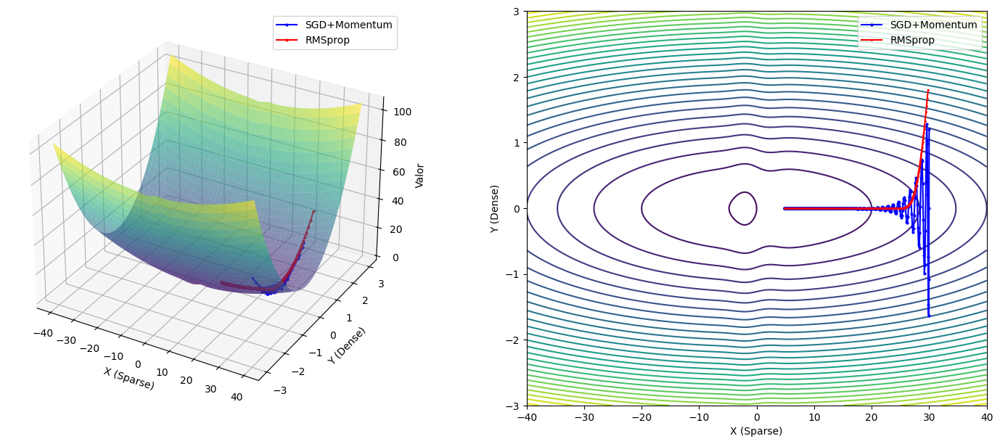

In [50]:
import matplotlib.gridspec as gridspec

# Función con una dimensión sparse (x) y otra con gradientes fuertes (y)
def sparse_function(x, y):
    # x tiene gradientes muy pequeños excepto cerca de ciertos puntos
    # y tiene gradientes consistentemente grandes
    return 0.01 * x**2 + 10 * y**2 + 5 * np.exp(-0.1 * x**2) * np.sin(0.1 * x) + 0.1 * y

# Derivadas parciales
def gradiente_x(x, y):
    # Gradiente muy pequeño en la mayoría de lugares
    return 0.02 * x - 0.5 * x * np.exp(-0.1 * x**2) * np.sin(0.1 * x) + 0.1 * np.exp(-0.1 * x**2) * np.cos(0.1 * x)

def gradiente_y(x, y):
    # Gradiente consistentemente grande
    return 20 * y + 0.1

# SGD con Momentum
def sgd_momentum(x_inicio, y_inicio, tasa_aprendizaje, momentum, iteraciones):
    trayectoria = []
    x, y = x_inicio, y_inicio
    velocidad_x, velocidad_y = 0, 0
    costes = []
    
    for _ in range(iteraciones):
        grad_x = gradiente_x(x, y)
        grad_y = gradiente_y(x, y)
        
        # Actualizar velocidades con momentum
        velocidad_x = momentum * velocidad_x - tasa_aprendizaje * grad_x
        velocidad_y = momentum * velocidad_y - tasa_aprendizaje * grad_y
        
        # Actualizar posiciones
        x = x + velocidad_x
        y = y + velocidad_y
        
        coste = sparse_function(x, y)
        costes.append(coste)
        trayectoria.append((x, y, coste))
    
    return np.array(trayectoria), np.array(costes)

# RMSprop
def rmsprop(x_inicio, y_inicio, tasa_aprendizaje, beta, epsilon, iteraciones):
    trayectoria = []
    x, y = x_inicio, y_inicio
    media_cuadratica_x, media_cuadratica_y = 0, 0
    costes = []
    
    for _ in range(iteraciones):
        grad_x = gradiente_x(x, y)
        grad_y = gradiente_y(x, y)
        
        # Actualizar media cuadrática del gradiente
        media_cuadratica_x = beta * media_cuadratica_x + (1 - beta) * grad_x**2
        media_cuadratica_y = beta * media_cuadratica_y + (1 - beta) * grad_y**2
        
        # Guardar estas métricas para visualización
        rms_x = np.sqrt(media_cuadratica_x) + epsilon
        rms_y = np.sqrt(media_cuadratica_y) + epsilon
        
        # Actualizar posiciones con tasa adaptativa
        x = x - tasa_aprendizaje * grad_x / rms_x
        y = y - tasa_aprendizaje * grad_y / rms_y
        
        coste = sparse_function(x, y)
        costes.append(coste)
        trayectoria.append((x, y, coste))
    
    return np.array(trayectoria), np.array(costes)

# Parámetros
x_inicio, y_inicio = 30.0, 2.0  # Punto inicial lejos del mínimo
iteraciones = 2000

# Parámetros específicos para cada optimizador
tasa_momentum = 0.02
momentum = 0.9

tasa_rmsprop = 0.02
beta_rmsprop = 0.99
epsilon = 1e-8

# Ejecutar algoritmos
trayectoria_momentum, costes_momentum = sgd_momentum(x_inicio, y_inicio, tasa_momentum, momentum, iteraciones)
trayectoria_rmsprop, costes_rmsprop = rmsprop(x_inicio, y_inicio, tasa_rmsprop, beta_rmsprop, epsilon, iteraciones)

# Crear malla para la superficie
x = np.linspace(-40, 40, 200)
y = np.linspace(-3, 3, 200)
X, Y = np.meshgrid(x, y)
Z = sparse_function(X, Y)

# Visualización
fig = plt.figure(figsize=(18, 16))
gs = gridspec.GridSpec(3, 2, height_ratios=[2, 1, 1])

# Gráfico 1: Superficie 3D con trayectorias
ax1 = fig.add_subplot(gs[0, 0], projection='3d')
superficie = ax1.plot_surface(X, Y, Z, cmap=cm.viridis, alpha=0.6, linewidth=0)
ax1.plot(trayectoria_momentum[:, 0], trayectoria_momentum[:, 1], trayectoria_momentum[:, 2], 'o-', color='blue', markersize=2, label='SGD+Momentum')
ax1.plot(trayectoria_rmsprop[:, 0], trayectoria_rmsprop[:, 1], trayectoria_rmsprop[:, 2], 'o-', color='red', markersize=2, label='RMSprop')
ax1.set_xlabel('X (Sparse)')
ax1.set_ylabel('Y (Dense)')
ax1.set_zlabel('Valor')
ax1.legend()

# Gráfico 2: Contorno con trayectorias
ax2 = fig.add_subplot(gs[0, 1])
contorno = ax2.contour(X, Y, Z, 30, cmap=cm.viridis)
ax2.plot(trayectoria_momentum[:, 0], trayectoria_momentum[:, 1], 'o-', color='blue', markersize=2, label='SGD+Momentum')
ax2.plot(trayectoria_rmsprop[:, 0], trayectoria_rmsprop[:, 1], 'o-', color='red', markersize=1, label='RMSprop')
ax2.set_xlabel('X (Sparse)')
ax2.set_ylabel('Y (Dense)')
ax2.legend()


# Regularización efectos

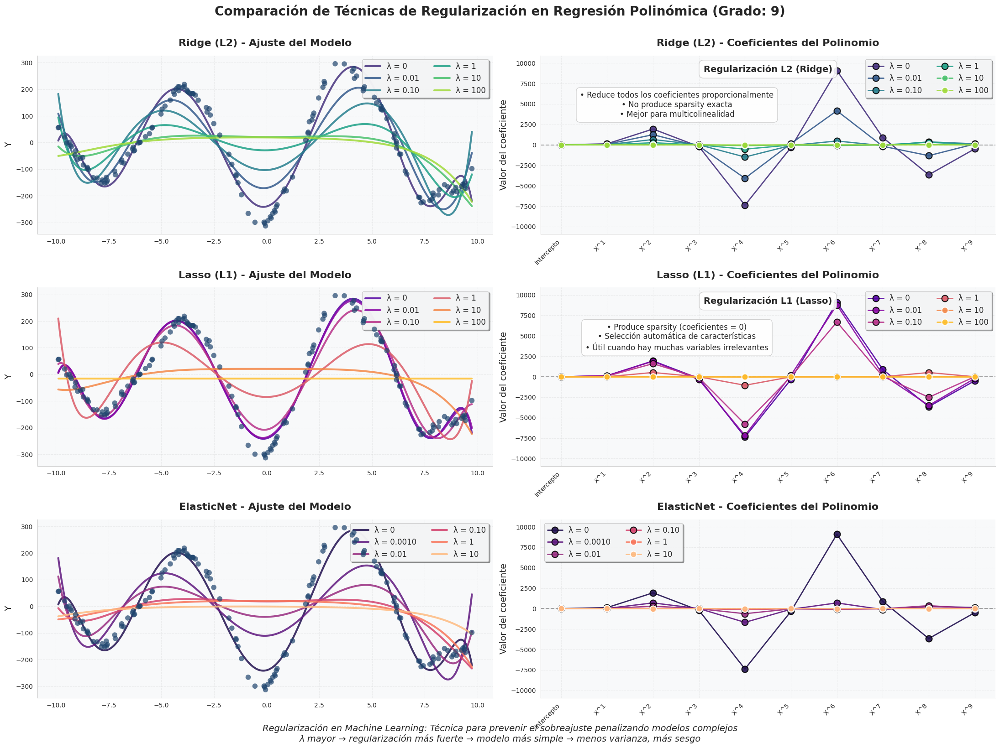

In [51]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import Ridge, Lasso, ElasticNet, LinearRegression
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.pipeline import Pipeline
import seaborn as sns
from sklearn.exceptions import ConvergenceWarning
import warnings

# Suprimir advertencias específicas
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# Configuración para reproducibilidad y estilo visual
np.random.seed(42)
sns.set_style("whitegrid")
plt.rcParams.update({
    'font.family': 'DejaVu Sans',
    'axes.facecolor': '#f8f9fa',
    'figure.facecolor': 'white'
})

def generar_datos_complejos(n_muestras=100, ruido=0.5, seed=42):
    """
    Genera datos sintéticos con patrones complejos para demostrar regularización.
    
    Args:
        n_muestras: Número de puntos de datos
        ruido: Magnitud del ruido aleatorio
        seed: Semilla para reproducibilidad
    
    Returns:
        X: Features (entrada)
        y: Target (salida)
    """
    np.random.seed(seed)
    X = np.sort(np.random.uniform(-10, 10, n_muestras))  # Reducido el rango para mejor estabilidad
    
    # Función simplificada para evitar inestabilidad numérica
    y = (
        5 * np.sin(0.5 * X) + 
        -3 * np.cos(0.8 * X) * (10 - np.abs(X)/2) +
        2 * np.sin(2.5 * X) +
        1.5 * np.sin(0.2 * X**2) +
        np.random.normal(0, ruido, n_muestras)
    )
    
    # Efectos regionales adicionales
    y += np.where(X < -5, 3 * np.sin(0.7 * X), 0)
    y += np.where(X > 5, -2 * np.cos(0.6 * X), 0)
    
    # Escalar para hacer los patrones más visibles pero sin exagerar
    return X.reshape(-1, 1), y * 10

def crear_modelo(tipo_reg, grado, lmbda):
    """
    Crea un pipeline con un modelo de regularización específico.
    Incluye escalado de características para mejor convergencia.
    
    Args:
        tipo_reg: Tipo de regularización ('ridge', 'lasso', 'elasticnet' o 'linear')
        grado: Grado del polinomio
        lmbda: Parámetro de regularización (alpha)
    
    Returns:
        Pipeline configurado con el regresor elegido
    """
    # Usar LinearRegression cuando lambda es 0
    if lmbda == 0:
        regresor = LinearRegression()
    else:
        regresor_map = {
            'ridge': Ridge(alpha=lmbda, max_iter=10000, tol=1e-3, solver='auto'),
            'lasso': Lasso(alpha=lmbda, max_iter=100000, tol=1e-4, selection='random'),
            'elasticnet': ElasticNet(alpha=lmbda, l1_ratio=0.5, max_iter=100000, tol=1e-4)
        }
        regresor = regresor_map[tipo_reg.lower()]
    
    # Añadir escalado para mejor convergencia
    return Pipeline([
        ('poly', PolynomialFeatures(degree=grado)),
        ('scaler', StandardScaler()),  # Importante para la convergencia
        ('reg', regresor)
    ])

def main():
    # Parámetros
    grado = 9  # Grado del polinomio
    n_muestras = 150  # Número de muestras para los datos
    
    # Generar datos
    X, y = generar_datos_complejos(n_muestras, ruido=0.8)
    X_plot = np.linspace(X.min(), X.max(), 1000).reshape(-1, 1)
    
    # Configuración de visualización
    fig = plt.figure(figsize=(22, 16))
    fig.suptitle(f'Comparación de Técnicas de Regularización en Regresión Polinómica (Grado: {grado})',
                 y=1.02, fontsize=20, fontweight='bold')
    
    # Paletas de colores mejoradas para mejor distinción
    paletas = {
        'Ridge (L2)': sns.color_palette("viridis", 6),
        'Lasso (L1)': sns.color_palette("plasma", 6),
        'ElasticNet': sns.color_palette("magma", 6)
    }
    
    # Valores lambda optimizados - empiezan desde pequeños valores >0 para evitar problemas de convergencia
    modelos_lambdas = {
        'Ridge (L2)': [0, 0.01, 0.1, 1, 10, 100],
        'Lasso (L1)': [0, 0.01, 0.1, 1, 10, 100],
        'ElasticNet': [0, 0.001, 0.01, 0.1, 1, 10]
    }
    
    # Estilos para las gráficas
    estilo_curva = {'linewidth': 3, 'alpha': 0.85}
    estilo_coef = {'markersize': 10, 'linewidth': 2, 'alpha': 0.9, 'markeredgewidth': 1.5}
    estilo_datos = {'color': '#1f456e', 'alpha': 0.7, 's': 70, 'zorder': 10, 'edgecolor': 'none'}
    
    # Crear subplots
    axs = fig.subplots(3, 2)
    
    # Calcular límites y para coeficientes
    coefs_data = []
    
    for tipo, lambdas in modelos_lambdas.items():
        tipo_simple = tipo.split()[0].lower()
        for lmbda in lambdas:
            model = crear_modelo(tipo_simple, grado, lmbda)
            model.fit(X, y)
            
            # Extraer coeficientes correctamente según el tipo de modelo
            if lmbda == 0:
                # LinearRegression guarda los coeficientes de manera diferente
                poly = model.named_steps['poly']
                features_names = poly.get_feature_names_out()
                coefs = model.named_steps['reg'].coef_
            else:
                coefs = model.named_steps['reg'].coef_
                
            coefs_data.append(coefs)
    
    y_min = min([np.min(c) for c in coefs_data])
    y_max = max([np.max(c) for c in coefs_data])
    max_abs = max(abs(y_min), abs(y_max)) * 1.2
    y_lim = (-max_abs, max_abs)

    # Longitud de los coeficientes para usar en etiquetas
    coef_length = len(coefs_data[0])

    # Plotear cada tipo de regularización
    for row, (tipo, lambdas) in enumerate(modelos_lambdas.items()):
        ax_curva, ax_coef = axs[row, 0], axs[row, 1]
        tipo_simple = tipo.split()[0].lower()
        
        # Plotear los datos originales
        ax_curva.scatter(X, y, **estilo_datos)
        ax_coef.axhline(0, color='gray', linestyle='--', linewidth=1.5, alpha=0.7)
        
        # Plotear cada valor lambda
        for i, lmbda in enumerate(lambdas):
            # Entrenar el modelo (sin warnings gracias al filtrado)
            model = crear_modelo(tipo_simple, grado, lmbda)
            model.fit(X, y)
            
            # Obtener predicciones y coeficientes
            y_pred = model.predict(X_plot)
            
            if lmbda == 0:
                # LinearRegression tiene una estructura diferente
                coefs = model.named_steps['reg'].coef_
            else:
                coefs = model.named_steps['reg'].coef_
            
            # Etiqueta formateada
            if lmbda == 0:
                label = f'λ = {lmbda}'
            elif lmbda < 0.01:
                label = f'λ = {lmbda:.4f}'
            elif lmbda < 1:
                label = f'λ = {lmbda:.2f}'
            else:
                label = f'λ = {int(lmbda)}'
            
            # Plotear curva y coeficientes
            ax_curva.plot(X_plot, y_pred, color=paletas[tipo][i], label=label, **estilo_curva)
            
            # Agregar borde negro o blanco a los marcadores para mejor contraste
            borde = 'w' if i > 3 else 'k'
            ax_coef.plot(range(len(coefs)), coefs, 'o-', color=paletas[tipo][i], 
                        label=label, markeredgecolor=borde, **estilo_coef)
            
        # Configuración de los gráficos
        for ax, titulo in zip([ax_curva, ax_coef], ['Ajuste del Modelo', 'Coeficientes del Polinomio']):
            ax.set_title(f'{tipo} - {titulo}', fontsize=16, fontweight='bold', pad=15)
            ax.set_ylabel('Y' if 'Modelo' in titulo else 'Valor del coeficiente', fontsize=14)
            
            # Leyenda con mejor ubicación y formato
            if 'Modelo' in titulo:
                ax.legend(fontsize=12, framealpha=0.95, fancybox=True, shadow=True, 
                         loc='upper right', ncol=2)
            else:
                ax.legend(fontsize=12, framealpha=0.95, fancybox=True, shadow=True, 
                         loc='best', ncol=2)
                ax.set_ylim(y_lim)
                
                # Etiquetas para los coeficientes
                ax.set_xticks(range(coef_length))
                labels = ['Intercepto'] + [f'X^{i}' for i in range(1, coef_length)]
                ax.set_xticklabels(labels, rotation=45, ha='right')
            
            # Mejora de la cuadrícula y el estilo general
            ax.grid(True, alpha=0.3, linestyle='--')
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            
        # Agregar anotaciones explicativas según el tipo de regularización
        explicaciones = {
            "Lasso (L1)": ("Regularización L1 (Lasso)", 
                          "• Produce sparsity (coeficientes = 0)\n• Selección automática de características\n• Útil cuando hay muchas variables irrelevantes"),
            "Ridge (L2)": ("Regularización L2 (Ridge)", 
                         "• Reduce todos los coeficientes proporcionalmente\n• No produce sparsity exacta\n• Mejor para multicolinealidad"),
            "ElasticNet (L1L2)": ("Regularización Mixta (ElasticNet)", 
                          "• Combina L1 y L2 (α·L1 + (1-α)·L2)\n• Balance entre selección y estabilidad\n• Útil para datos de alta dimensionalidad")
        }
        
        if tipo in explicaciones:
            titulo, texto = explicaciones[tipo]
            ax_coef.annotate(titulo, 
                        xy=(0.5, 0.95), xycoords='axes fraction',
                        ha='center', va='top', fontsize=14, fontweight='bold',
                        bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9,
                                edgecolor='#cccccc'))
            
            ax_coef.annotate(texto, 
                        xy=(0.3, 0.8), xycoords='axes fraction',
                        ha='center', va='top', fontsize=12,
                        bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9,
                                edgecolor='#cccccc'))
    
    # Agregar título general explicativo en la parte inferior
    fig.text(0.5, 0.01, 
            "\n\nRegularización en Machine Learning: Técnica para prevenir el sobreajuste penalizando modelos complejos\n"
            "λ mayor → regularización más fuerte → modelo más simple → menos varianza, más sesgo",
            ha='center', fontsize=14, fontstyle='italic')
    
    # Ajustar espaciado
    plt.tight_layout()
    plt.subplots_adjust(top=0.95, bottom=0.07, hspace=0.3)
    plt.show()

main()